# EDF data labelling

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import collections
import json
import os
from pathlib import Path
import pyedflib
import re
from subprocess import call
import sys
import typing
import urllib
import torch

In [3]:
print(f'__Python VERSION: {sys.version}')

try:
    print(f'__pyTorch VERSION: {torch.__version__}')
    PYTORCH = True
except: 
    print("Pytorch Not Installed")
    PYTORCH = False

try:
    print(f'__fastai VERSION: {fastai.__version__}')
except:
    print("fastai Not Installed")
    
print('__CUDA VERSION')

! nvcc --version

if PYTORCH:
    print(f'__CUDNN VERSION: {torch.backends.cudnn.version()}')
    print(f'__Number CUDA Devices: {torch.cuda.device_count()}')
    
print(f'__Devices')

try:
    call(["nvidia-smi", "--format=csv", "--query-gpu=index,name,driver_version,memory.total,memory.used,memory.free"])
    print(f'Active CUDA Device: GPU {torch.cuda.current_device()}')

    print (f'Available devices: {torch.cuda.device_count()}')
    print (f'Current cuda device {torch.cuda.current_device()}')
except:
    print("No GPUs Found")

__Python VERSION: 3.9.16 (main, Mar  8 2023, 10:39:24) [MSC v.1916 64 bit (AMD64)]
__pyTorch VERSION: 1.13.1+cu116
fastai Not Installed
__CUDA VERSION
nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Tue_Mar__8_18:36:24_Pacific_Standard_Time_2022
Cuda compilation tools, release 11.6, V11.6.124
Build cuda_11.6.r11.6/compiler.31057947_0
__CUDNN VERSION: 8302
__Number CUDA Devices: 2
__Devices
Active CUDA Device: GPU 0
Available devices: 2
Current cuda device 0


# Paths

In [4]:
here = Path(f'{os.getcwd()}')
# data_path = here.parent/'data'
# raw_path = data_path/'raw'/'v1.5.0/edf'
print(here)

c:\Users\dhc40\gpu_dhc\tuh_eeg\nbs


In [21]:
data_path=r'C:\Users\dhc40\AppData\Roaming\MobaXterm\home'
# print(data_path)
raw_path=data_path+r'\v2.0.0\edf'
print(raw_path)

C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf


# Build List of Files

working files 밑에 있는 edf의 개수 파악해보기

In [22]:
working_files = []
for (dir_path, dir_names, file_names) in os.walk(raw_path):
    max_eeg = [re.search('t(\d*)',file.split('/')[-1])[1] for file in file_names]
    m = max(max_eeg) if len(max_eeg) >= 1 else 0
    for file in file_names:
        if file.endswith('.edf'):
            working_files.append((dir_path + '\\' + file, m))

총 edf 개수 69652개

In [23]:
len(working_files)

69652

working_files 통해 경로 확인

In [24]:
working_files[:5]

[('C:\\Users\\dhc40\\AppData\\Roaming\\MobaXterm\\home\\v2.0.0\\edf\\000\\aaaaaaaa\\s001_2015_12_30\\01_tcp_ar\\aaaaaaaa_s001_t000.edf',
  '000'),
 ('C:\\Users\\dhc40\\AppData\\Roaming\\MobaXterm\\home\\v2.0.0\\edf\\000\\aaaaaaab\\s001_2002_12_30\\02_tcp_le\\aaaaaaab_s001_t000.edf',
  '005'),
 ('C:\\Users\\dhc40\\AppData\\Roaming\\MobaXterm\\home\\v2.0.0\\edf\\000\\aaaaaaab\\s001_2002_12_30\\02_tcp_le\\aaaaaaab_s001_t001.edf',
  '005'),
 ('C:\\Users\\dhc40\\AppData\\Roaming\\MobaXterm\\home\\v2.0.0\\edf\\000\\aaaaaaab\\s001_2002_12_30\\02_tcp_le\\aaaaaaab_s001_t003.edf',
  '005'),
 ('C:\\Users\\dhc40\\AppData\\Roaming\\MobaXterm\\home\\v2.0.0\\edf\\000\\aaaaaaab\\s001_2002_12_30\\02_tcp_le\\aaaaaaab_s001_t004.edf',
  '005')]

In [9]:
# make sure that they all have the same structure
nums = []
for file, m in working_files:
    print(file,m)
    nums.append(len(file.split('/')))
collections.Counter(nums)

C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaaa\s001_2015_12_30\01_tcp_ar\aaaaaaaa_s001_t000.edf 000
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s001_2002_12_30\02_tcp_le\aaaaaaab_s001_t000.edf 005
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s001_2002_12_30\02_tcp_le\aaaaaaab_s001_t001.edf 005
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s001_2002_12_30\02_tcp_le\aaaaaaab_s001_t003.edf 005
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s001_2002_12_30\02_tcp_le\aaaaaaab_s001_t004.edf 005
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s001_2002_12_30\02_tcp_le\aaaaaaab_s001_t005.edf 005
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s002_2002_12_30\02_tcp_le\aaaaaaab_s002_t000.edf 001
C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\edf\000\aaaaaaab\s002_2002_12_30\02_tcp_le\aaaaaaab_s002_t001.edf 001
C:\Users\dhc40\A

Counter({1: 69652})

# Plotting Random EDF files

In [10]:
d = collections.defaultdict(list)
d

defaultdict(list, {})

## 그냥 랜덤으로 plotting해보기

5분 미만의 recording은 제거


In [25]:
import random
import os
import pickle
import pyedflib
import numpy as np
import matplotlib.pyplot as plt

def select_by_duration(working_files, tmin=0, tmax=None):
    if tmax is None:
        tmax = np.inf
    # determine length of the recordings and select based on tmin and tmax
    selected_files = []
    for file_path in working_files:
        # EDF 파일 열기
        edf_reader = pyedflib.EdfReader(file_path)
        # print(edf_reader)
        duration = edf_reader.file_duration
        if tmin <= duration <= tmax:
            selected_files.append(file_path)

    return selected_files

tmin = 5 * 60
tmax = None
selected_files = select_by_duration([f[0] for f in working_files], tmin, tmax)

In [9]:
# 랜덤하게 선택할 파일의 개수 설정
num_files_to_visualize = 10
random_files = random.sample(selected_files, num_files_to_visualize)

random plotting (all channel)

In [12]:
# 파일들을 순회하면서 시각화
for file_path in random_files:
    # EDF 파일 열기
    edf_reader = pyedflib.EdfReader(file_path)
    # 채널 정보 확인
    num_channels = edf_reader.signals_in_file
    channel_labels = edf_reader.getSignalLabels()
    # print(channel_labels)
    sample_frequencies = edf_reader.getSampleFrequencies()

    # 시각화할 전체 그래프 생성
    plt.figure()

    # 채널별로 시그널 데이터를 가져와서 시각화
    for channel_index in range(num_channels):
        signal = edf_reader.readSignal(channel_index)

        # 시간 배열 생성 (시그널 데이터의 길이에 따라 샘플 개수 만큼 생성)
        sample_frequency = edf_reader.getSampleFrequencies()[channel_index]
        duration = len(signal) / sample_frequency
        time = np.linspace(0, duration, len(signal))

        # 채널 이름과 시그널 데이터를 한 그래프에 시각화
        plt.plot(time, signal, label=channel_labels[channel_index])

    # 전체 그래프 설정
    plt.xlabel("Time (seconds)")
    plt.ylabel("Signal Amplitude")
    plt.title(f"EDF File: {file_path} (Number of channels: {num_channels})")

    # 범례 위치와 가로 정렬 개수 설정하여 범주를 그래프 구역 바깥에 옮김
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=num_channels // 10)

    # 파일 닫기
    edf_reader.close()

    plt.show()


channel mapping => 여기서 ref채널은 ar///LE 채널은 le

Next, we will discard all recordings that have an incomplete channel configuration (wrt the channels that we are interested in, i.e. the 21 channels of the international 10-20-placement). The dataset is subdivided into recordings with ‘le’ and ‘ar’ reference which we will have to consider. Data is not loaded here.

In [26]:
short_ch_names = sorted([
    'A1', 'A2',
    'FP1', 'FP2', 'F3', 'F4', 'C3', 'C4', 'P3', 'P4', 'O1', 'O2',
    'F7', 'F8', 'T3', 'T4', 'T5', 'T6', 'FZ', 'CZ', 'PZ'])

# channel name of AR and LE
ar_ch_names = sorted([
    'EEG A1-REF', 'EEG A2-REF',
    'EEG FP1-REF', 'EEG FP2-REF', 'EEG F3-REF', 'EEG F4-REF', 'EEG C3-REF',
    'EEG C4-REF', 'EEG P3-REF', 'EEG P4-REF', 'EEG O1-REF', 'EEG O2-REF',
    'EEG F7-REF', 'EEG F8-REF', 'EEG T3-REF', 'EEG T4-REF', 'EEG T5-REF',
    'EEG T6-REF', 'EEG FZ-REF', 'EEG CZ-REF', 'EEG PZ-REF'])
le_ch_names = sorted([
    'EEG A1-LE', 'EEG A2-LE',
    'EEG FP1-LE', 'EEG FP2-LE', 'EEG F3-LE', 'EEG F4-LE', 'EEG C3-LE',
    'EEG C4-LE', 'EEG P3-LE', 'EEG P4-LE', 'EEG O1-LE', 'EEG O2-LE',
    'EEG F7-LE', 'EEG F8-LE', 'EEG T3-LE', 'EEG T4-LE', 'EEG T5-LE',
    'EEG T6-LE', 'EEG FZ-LE', 'EEG CZ-LE', 'EEG PZ-LE'])
combined_ch_names = ar_ch_names + le_ch_names
assert len(short_ch_names) == len(ar_ch_names) == len(le_ch_names)
ar_ch_mapping = {ch_name: short_ch_name for ch_name, short_ch_name in zip(
    ar_ch_names, short_ch_names)}
le_ch_mapping = {ch_name: short_ch_name for ch_name, short_ch_name in zip(
    le_ch_names, short_ch_names)}
ch_mapping = {'ar': ar_ch_mapping, 'le': le_ch_mapping}

In [27]:
output_dir=r'C:\Users\dhc40\AppData\Roaming\MobaXterm\home\v2.0.0\new_edf'

기본 전처리를 진행하기 전에 window 60초로 잘라서 (eeg만) plotting
edf를 sequence length 60s split

In [29]:
# 전체 코드 내용은 여기에 와야 함

# Process and visualize EEG data for each file
for file_path in selected_files[:]:  # Process all files
    with pyedflib.EdfReader(file_path) as f:
        edf_filename = os.path.basename(file_path)  # Extract the EDF file name
        channel_labels = f.getSignalLabels()
        sample_frequencies = f.getSampleFrequencies()

        eeg_channels = [ch for ch in channel_labels if ch in combined_ch_names]
        if len(eeg_channels) > 0:
            eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

            # Calculate the total number of samples and the number of samples in a 60-second window
            total_samples = int(f.getNSamples()[0])
            window_size = int(60 * sample_frequencies[0])
            
            # Iterate through the data using windows
        for start_idx in range(0, total_samples - window_size + 1, window_size):
            end_idx = start_idx + window_size

            # Load EEG data for the window
            eeg_data = [f.readSignal(idx, start=start_idx, n=window_size) for idx in eeg_indices]

            # Create a time array for the x-axis
            time_axis = np.arange(start_idx / sample_frequencies[0], end_idx / sample_frequencies[0], 1 / sample_frequencies[0])
    
            # # # Visualization
            # plt.figure(figsize=(12, 6))
            # for channel_data, label in zip(eeg_data, eeg_channels):
            #     plt.plot(time_axis, channel_data, label=label)
            # plt.title(f"EEG Data - {edf_filename}\nWindow: {start_idx / sample_frequencies[0]:.1f}s - {end_idx / sample_frequencies[0]:.1f}s")
            # plt.xlabel("Time (s)")  # Updated x-axis label
            # plt.ylabel("Amplitude")
            # plt.legend()
            # plt.grid(True)
            # plt.show()

            # Save window data as a pickle file in the output directory
            window_data = {
                'channel_labels': eeg_channels,
                'data': eeg_data,
                'sample_frequencies': sample_frequencies,
                'start_idx': start_idx,
                'end_idx': end_idx,
                'edf_filename': edf_filename
            }
            window_filename = os.path.join(output_dir, f"{os.path.splitext(edf_filename)[0]}_window_{start_idx // window_size}.pkl")
            
            with open(window_filename, 'wb') as pickle_file:
                pickle.dump(window_data, pickle_file)
            # with open(window_filename, 'rb') as pickle_file:
            #     pkl_data = pickle.load(pickle_file)
            #     print(pkl_data)




250.0
389000
15000


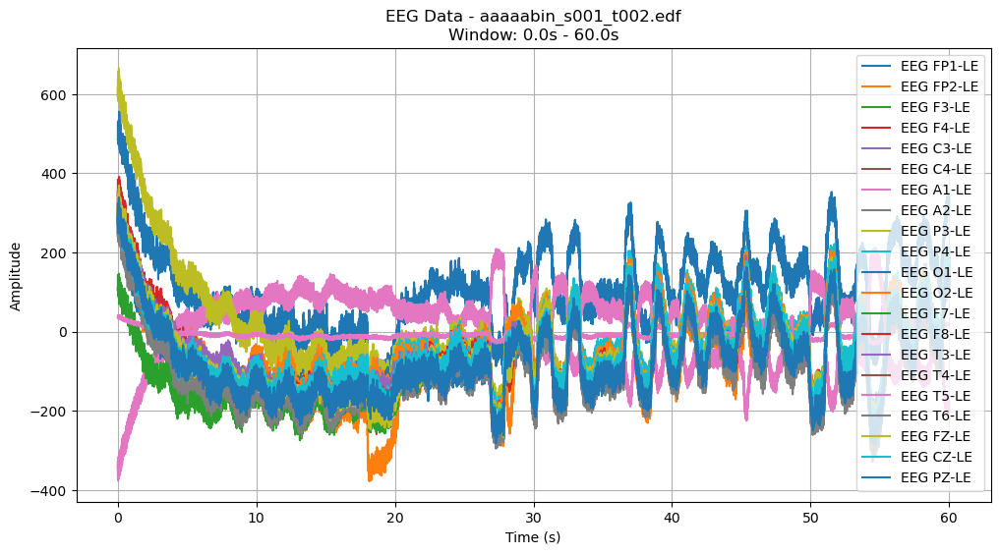

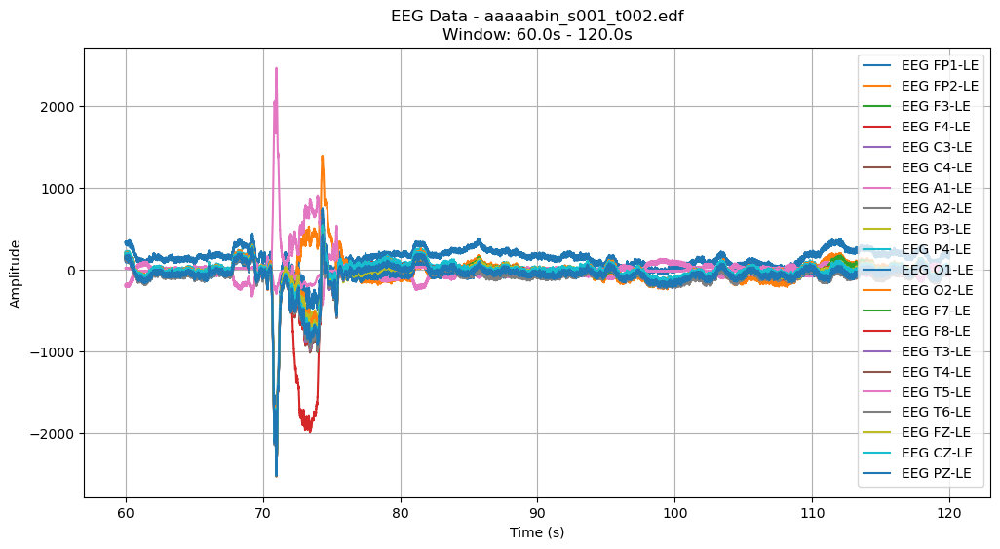

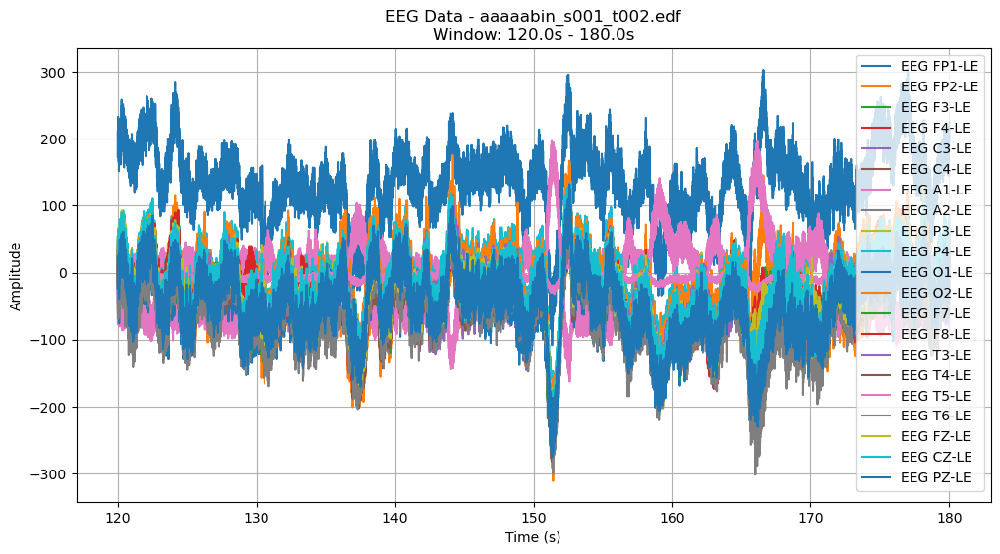

KeyboardInterrupt: 

In [29]:
import os
import pickle

tmin = 1 * 60
tmax = 6 * 60

# Create a directory to store pickle files
output_dir = "path_to_save_pickles"
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Process and visualize EEG data for each file
for file_path in selected_files[:10]:  # Process all files
    with pyedflib.EdfReader(file_path) as f:
        edf_filename = os.path.basename(file_path)  # Extract the EDF file name
        channel_labels = f.getSignalLabels()
        sample_frequencies = f.getSampleFrequencies()
        # print(sample_frequencies[0])=>250
        eeg_channels = [ch for ch in channel_labels if ch in combined_ch_names]
        if len(eeg_channels) > 0:
            eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

            # Calculate the total number of samples and the number of samples in a 60-second window
            total_samples = int(f.getNSamples()[0])  # Convert to integer
            # print(total_samples) => sample 하나당 window size 60*250=15000이니까 15000*25=375000, total sample은 389000 
            window_size = int(60 * sample_frequencies[0])  # Convert to integer
            # print(window_size)


        # Iterate through the data using windows
        for start_idx in range(0, total_samples - window_size + 1, window_size):
            end_idx = start_idx + window_size

            # Load EEG data for the window
            eeg_data = [f.readSignal(idx, start=start_idx, n=window_size) for idx in eeg_indices]

            # Create a time array for the x-axis
            time_axis = np.arange(start_idx / sample_frequencies[0], end_idx / sample_frequencies[0], 1 / sample_frequencies[0])

            # Visualization
            plt.figure(figsize=(12, 6))
            for channel_data, label in zip(eeg_data, eeg_channels):
                plt.plot(time_axis, channel_data, label=label)
            plt.title(f"EEG Data - {edf_filename}\nWindow: {start_idx / sample_frequencies[0]:.1f}s - {end_idx / sample_frequencies[0]:.1f}s")
            plt.xlabel("Time (s)")  # Updated x-axis label
            plt.ylabel("Amplitude")
            plt.legend()
            plt.grid(True)
            plt.show()

            # Save window data as a pickle file in the output directory
            window_data = {'channel_labels': eeg_channels, 'data': eeg_data}
            window_filename = os.path.join(output_dir, f"{os.path.splitext(edf_filename)[0]}_window_{start_idx // window_size}.pkl")
            with open(window_filename, 'wb') as pickle_file:
                pickle.dump(window_data, pickle_file)



## 기본 전처리 (With bandpass) 한 후 plotting

In [23]:
current_directory = os.getcwd()  # 현재 작업 디렉토리를 얻습니다.
print(current_directory)

c:\Users\dhc40\gpu_dhc\tuh_eeg\nbs


bandpass filter filtering

In [24]:
import os
import numpy as np
import pyedflib
import matplotlib.pyplot as plt
from scipy.signal import resample, butter, lfilter
# Bandpass 필터 파라미터
lowcut = 0.5  # 최소 주파수
highcut = 70.0  # 최대 주파수
order = 4  # 필터 차수
# Butterworth Bandpass 필터 함수
def butter_bandpass(lowcut, highcut, fs, order=5):
    nyquist = 0.5 * fs
    low = lowcut / nyquist
    high = highcut / nyquist
    b, a = butter(order, [low, high], btype='band')
    return b, a

def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

<Figure size 640x480 with 0 Axes>

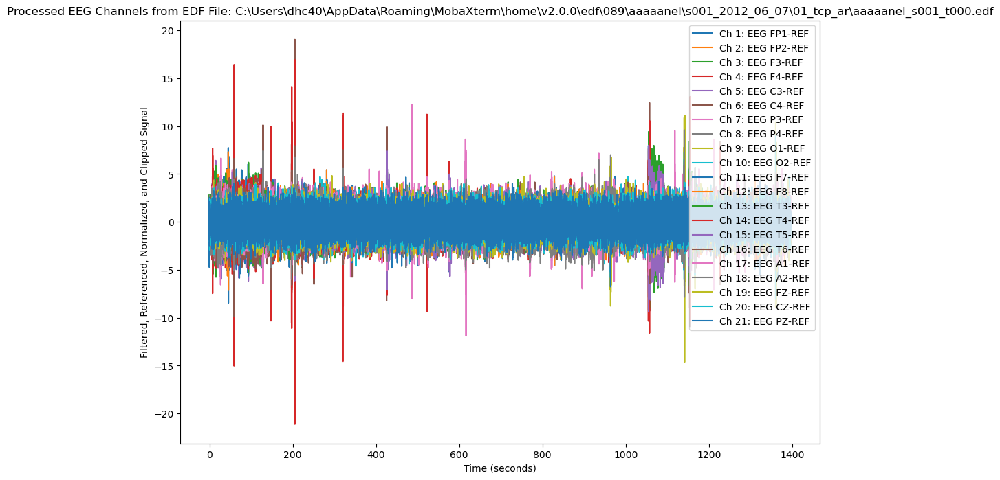

<Figure size 640x480 with 0 Axes>

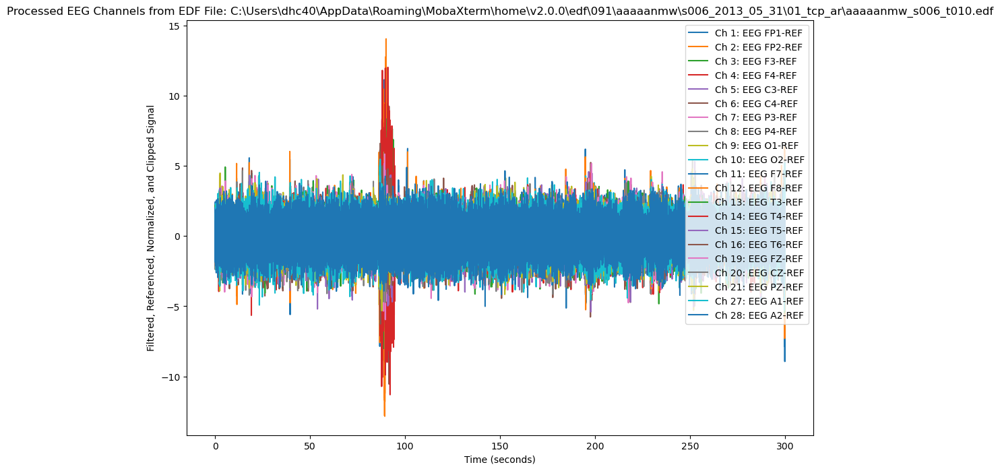

<Figure size 640x480 with 0 Axes>

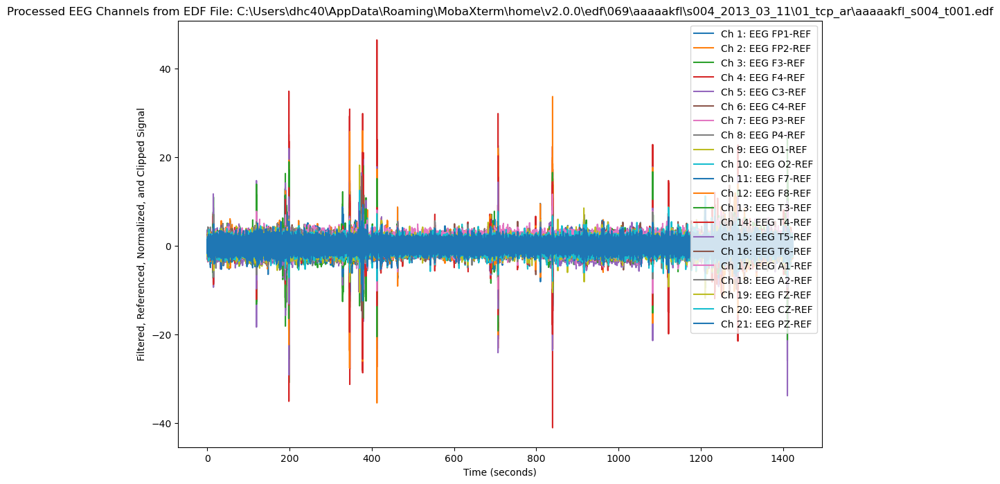

<Figure size 640x480 with 0 Axes>

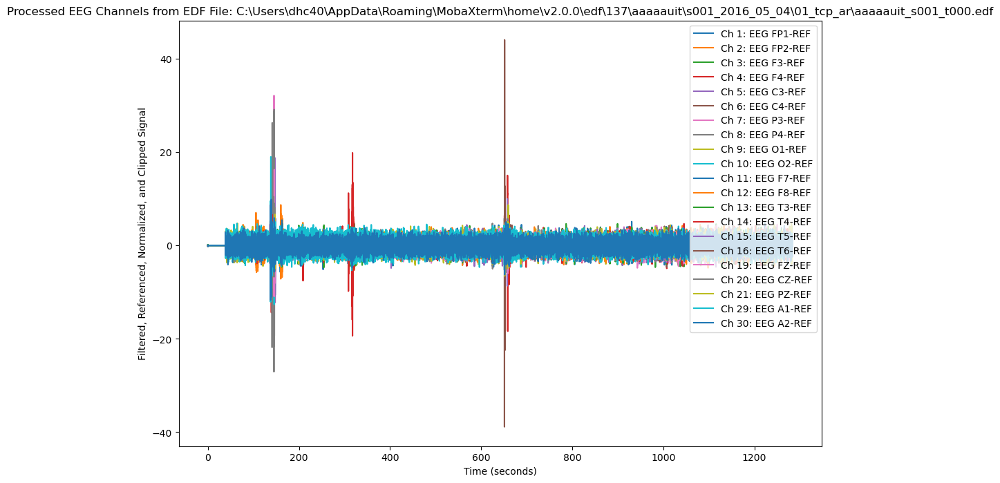

<Figure size 640x480 with 0 Axes>

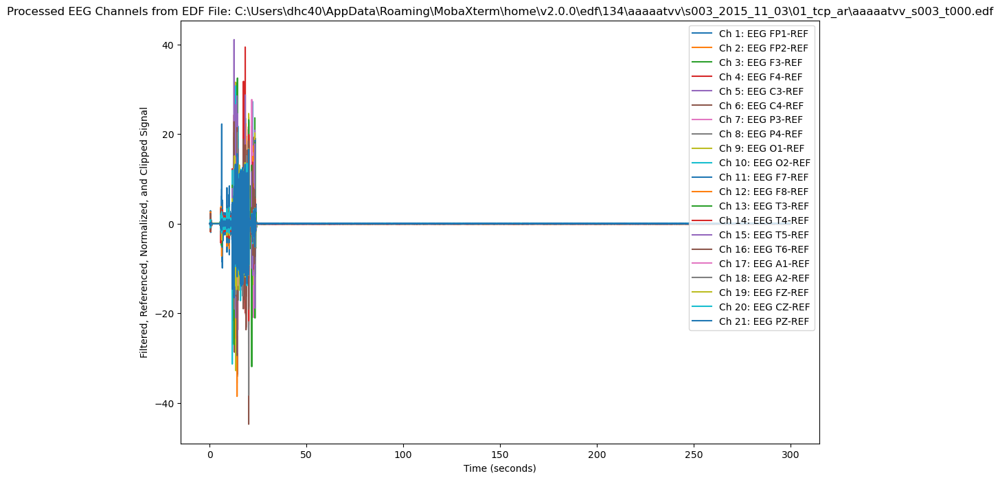

<Figure size 640x480 with 0 Axes>

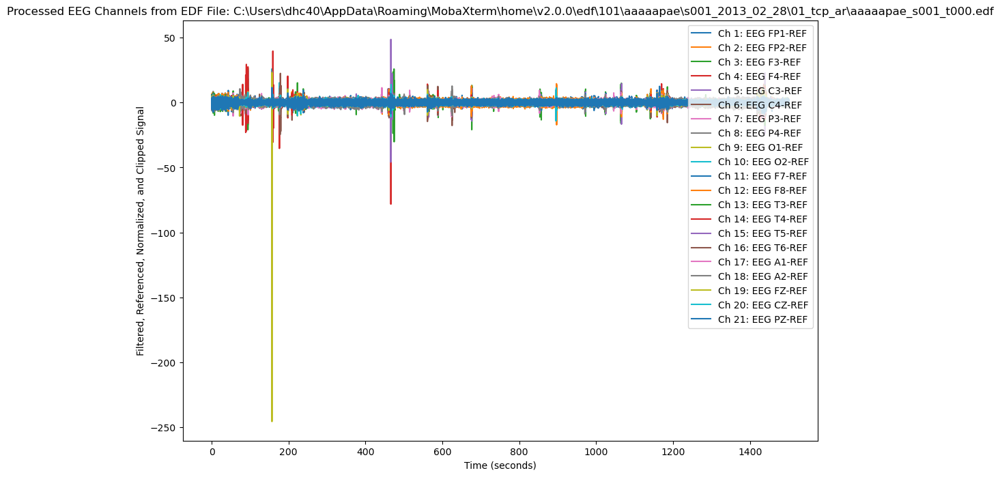

<Figure size 640x480 with 0 Axes>

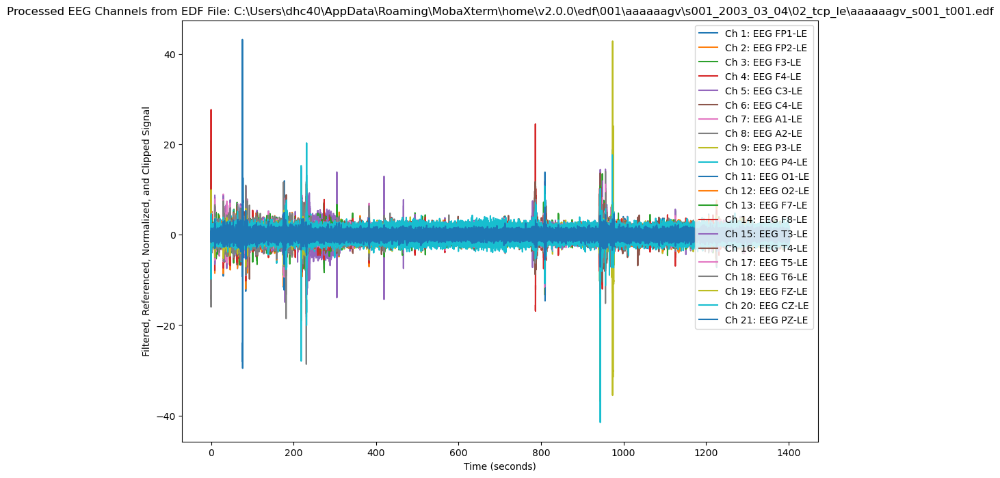

<Figure size 640x480 with 0 Axes>

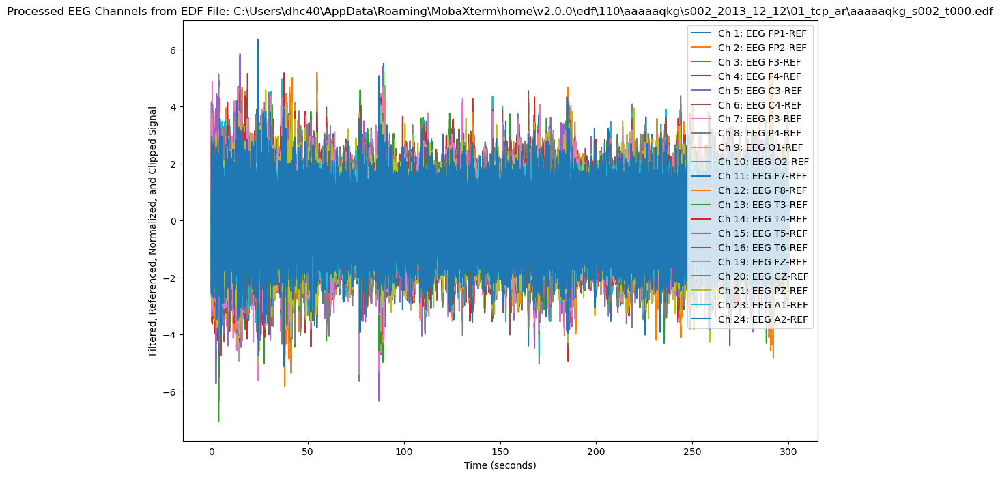

<Figure size 640x480 with 0 Axes>

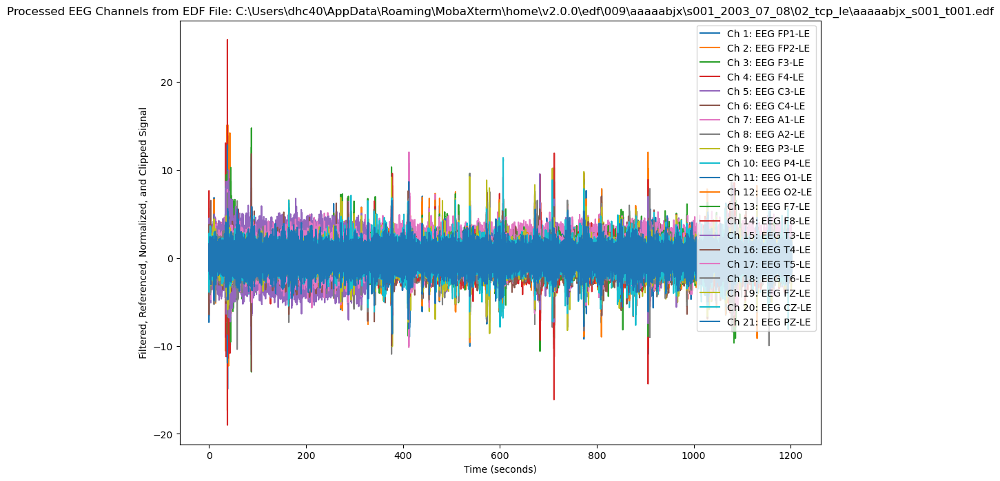

<Figure size 640x480 with 0 Axes>

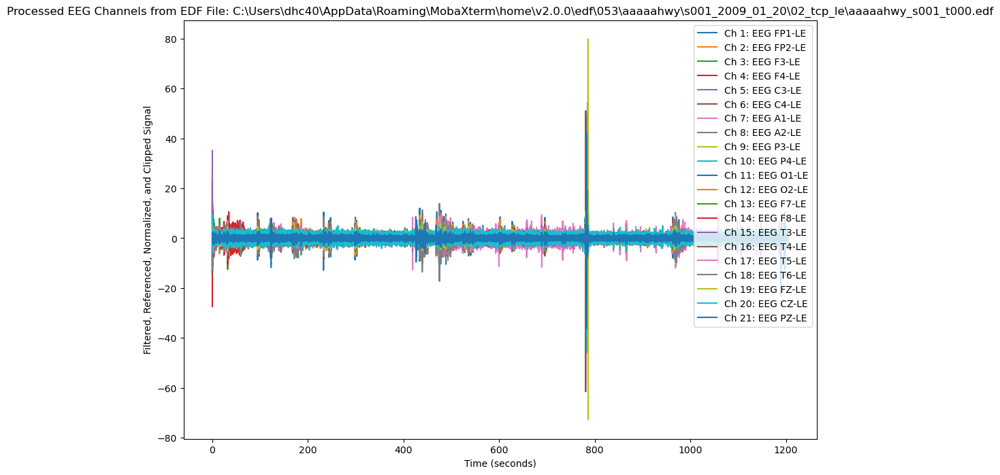

In [25]:
tmin = 1 * 60
tmax = 6 * 60
sfreq_target = 200  # 200Hz 리샘플링
clip_threshold = 500  # outlier 값 클리핑 임계값

# 작업 파일들을 순회하면서 EEG 데이터 전처리 및 시각화
for file_path in random_files[:10]:  # 모든 파일 처리
    with pyedflib.EdfReader(file_path) as f:
        channel_labels = f.getSignalLabels()
        sample_frequencies = f.getSampleFrequencies()
        # EEG 채널만 추출
        # eeg_channels = [ch for ch in channel_labels if ch.startswith("EEG")] => 이렇게 하면 안됨(21개 넘음)
        eeg_channels = [ch for ch in channel_labels if ch in combined_ch_names]
        if len(eeg_channels) > 0:  # EEG 채널이 존재하는 경우에만 처리
            eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

            # 시각화할 전체 그래프 생성
            plt.figure()

            # EEG 데이터 불러오기 및 전처리
            eeg_data = [f.readSignal(idx) for idx in eeg_indices]

            # Bandpass 필터링 적용
            eeg_data_filtered = []
            for signal in eeg_data:
                filtered_signal = butter_bandpass_filter(signal, lowcut, highcut, sfreq_target, order)
                eeg_data_filtered.append(filtered_signal)

            # 리샘플링
            num_original_samples = len(eeg_data_filtered[0])
            num_target_samples = int(num_original_samples * (sfreq_target / max(sample_frequencies)))
            eeg_data_resampled = [resample(signal, num_target_samples) for signal in eeg_data_filtered]

            # EEG 참조 적용 (여기서 'average'로 referencing을 적용)
            eeg_data_mean = np.mean(eeg_data_resampled, axis=0)
            eeg_data_referenced = [signal - eeg_data_mean for signal in eeg_data_resampled]

            # zero mean std 정규화
            eeg_data_normalized = [(signal - np.mean(signal)) / np.std(signal) for signal in eeg_data_referenced]

            # outlier 값 클리핑
            eeg_data_clipped = [np.clip(signal, -clip_threshold, clip_threshold) for signal in eeg_data_normalized]

            # 시간 배열 생성
            duration = len(eeg_data_clipped[0]) / sfreq_target
            time = np.linspace(0, duration, len(eeg_data_clipped[0]))

            # 시각화
            plt.figure(figsize=(12, 8))
            for idx, channel_index in enumerate(eeg_indices):
                plt.plot(time, eeg_data_clipped[idx], label=f"Ch {channel_index + 1}: {channel_labels[channel_index]}")
            plt.xlabel("Time (seconds)")
            plt.ylabel("Filtered, Referenced, Normalized, and Clipped Signal")
            plt.title(f"Processed EEG Channels from EDF File: {file_path}")
            plt.legend(loc='upper right')
            plt.show()

In [232]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 작업 파일들을 순회하면서 EEG 데이터 전처리 및 시각화
# for file_path in selected_files[:10]:  # 모든 파일 처리
#     with pyedflib.EdfReader(file_path) as f:
#         channel_labels = f.getSignalLabels()
#         sample_frequencies = f.getSampleFrequencies()

#         # EEG 채널만 추출
#         eeg_channels = [ch for ch in channel_labels if ch.startswith("EEG")]

#         if len(eeg_channels) > 0:  # EEG 채널이 존재하는 경우에만 처리
#             eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

#             # 시각화할 전체 그래프 생성
#             plt.figure()

#             # EEG 데이터 불러오기 및 전처리
#             eeg_data = [f.readSignal(idx) for idx in eeg_indices]

#             # 리샘플링
#             num_original_samples = len(eeg_data[0])
#             num_target_samples = int(num_original_samples * (sfreq_target / max(sample_frequencies)))
#             eeg_data_resampled = [resample(signal, num_target_samples) for signal in eeg_data]

#             # EEG 참조 적용 (여기서 'average'로 referencing을 적용)
#             eeg_data_mean = np.mean(eeg_data_resampled, axis=0)
#             eeg_data_referenced = [signal - eeg_data_mean for signal in eeg_data_resampled]

#             # 정규화 (0~1 사이로 스케일링) => 
#             # zero mean std 정규화
#             eeg_data_normalized = [(signal - np.mean(signal)) / np.std(signal) for signal in eeg_data_referenced]


#             # outlier 값 클리핑
#             eeg_data_clipped = [np.clip(signal, -clip_threshold, clip_threshold) for signal in eeg_data_normalized]

#             # 시간 배열 생성
#             duration = len(eeg_data_clipped[0]) / sfreq_target
#             time = np.linspace(0, duration, len(eeg_data_clipped[0]))

#             # 시각화
#             for idx, channel_index in enumerate(eeg_indices):
#                 plt.plot(time, eeg_data_clipped[idx], label=channel_labels[channel_index])
#             plt.xlabel("Time (seconds)")
#             plt.ylabel("Referenced, Normalized, and Clipped Signal")
#             plt.title(f"Referenced, Normalized, and Clipped EEG Channels from EDF File: {file_path}")
#             plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#             plt.show()


In [233]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 작업 파일들을 순회하면서 EEG 데이터 전처리 및 시각화
# for file_path in selected_files[:5]:  # 모든 파일 처리
#     with pyedflib.EdfReader(file_path) as f:
#         channel_labels = f.getSignalLabels()
#         sample_frequencies = f.getSampleFrequencies()

#         # EEG 채널만 추출
#         eeg_channels = [ch for ch in channel_labels if ch.startswith("EEG")]

#         if len(eeg_channels) > 0:  # EEG 채널이 존재하는 경우에만 처리
#             eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

#             # 시각화할 전체 그래프 생성
#             plt.figure()

#             # EEG 데이터 불러오기 및 전처리
#             eeg_data = [f.readSignal(idx) for idx in eeg_indices]

#             # 리샘플링
#             num_original_samples = len(eeg_data[0])
#             num_target_samples = int(num_original_samples * (sfreq_target / max(sample_frequencies)))
#             eeg_data_resampled = [resample(signal, num_target_samples) for signal in eeg_data]

#             # EEG 참조 적용 (여기서 'average'로 referencing을 적용)
#             eeg_data_mean = np.mean(eeg_data_resampled, axis=0)
#             eeg_data_referenced = [signal - eeg_data_mean for signal in eeg_data_resampled]

#             # 정규화 (0~1 사이로 스케일링)
#             # zero mean std 정규화
#             eeg_data_normalized = [(signal - np.mean(signal)) / np.std(signal) for signal in eeg_data_referenced]


#             # outlier 값 클리핑
#             eeg_data_clipped = [np.clip(signal, -clip_threshold, clip_threshold) for signal in eeg_data_normalized]

#             # 시간 배열 생성
#             duration = len(eeg_data_clipped[0]) / sfreq_target
#             time = np.linspace(0, duration, len(eeg_data_clipped[0]))

#             # 시각화
#             for idx, channel_index in enumerate(eeg_indices):
#                 plt.plot(time, eeg_data_clipped[idx], label=channel_labels[channel_index])
#             plt.xlabel("Time (seconds)")
#             plt.ylabel("Referenced, Normalized, and Clipped Signal")
#             plt.title(f"Referenced, Normalized, and Clipped EEG Channels from EDF File: {file_path}")
#             plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#             plt.show()


## channel별로 plotting

In [ ]:
# # 채널 분포 시각화
# plt.figure(figsize=(10, 8))
# for ch_type, ch_mapping_dict in ch_mapping.items():
#     # print(ch_type) => ar, le
#     # print(ch_mapping_dict) => {'EEG A1-REF': 'A1', 'EEG A2-REF': 'A2', ...}
#     ch_indices = []
#     for ch_name in ch_mapping_dict:
#         # print(channel_labels)
#         # ch_name => 'EEG FP1-REF'
#         if ch_name in [label for label in channel_labels]:
#             # print(ch_mapping_dict[ch_name]) => A2,C3,C4,CZ,F3,F4F7F8FP1FP2FZO1O2P3P4PZT3T4T5T6
#             # print(channel_labels.index(ch_mapping_dict[ch_name]))


In [243]:
# # 밑의 코드는 각 채널을 갖고 있는 모든 edf의 채널을 plotting한 건데 시간이 오래걸린다

# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample, butter, lfilter

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 새로운 figure 생성
# plt.figure(figsize=(12, 8))

# # 각 채널에 대해 데이터 샘플링하여 시각화
# for ch_name in combined_ch_names:
#     plt.figure(figsize=(12, 8))
#     for file_path in selected_files[:10000]:  # 모든 파일 처리
#         with pyedflib.EdfReader(file_path) as f:
#             channel_labels = f.getSignalLabels()
#             sample_frequencies = f.getSampleFrequencies()
            
#             if ch_name in channel_labels:
#                 channel_index = channel_labels.index(ch_name)

#                 # EEG 데이터 불러오기 및 전처리
#                 eeg_data = f.readSignal(channel_index)

#                 # 데이터 샘플링
#                 sample_indices = np.linspace(0, len(eeg_data) - 1, 1000).astype(int)
#                 sampled_data = eeg_data[sample_indices]

#                 # 시간 배열 생성
#                 duration = len(sampled_data) / sfreq_target
#                 time = np.linspace(0, duration, len(sampled_data))

#                 # 해당 채널 데이터 시각화
#                 plt.plot(time, sampled_data, label=f"File: {os.path.basename(file_path)}")
    
#     plt.xlabel("Time (seconds)")
#     plt.ylabel("Sampled Signal")
#     plt.title(f"Sampled EEG Channel: {ch_name}")
#     plt.legend()
#     plt.show()


랜덤으로 10개의 데이터 뽑고 (위에서) 각 데이터에서 채널별로 plotting한 뒤에 모든 채널 plotting까지 진행

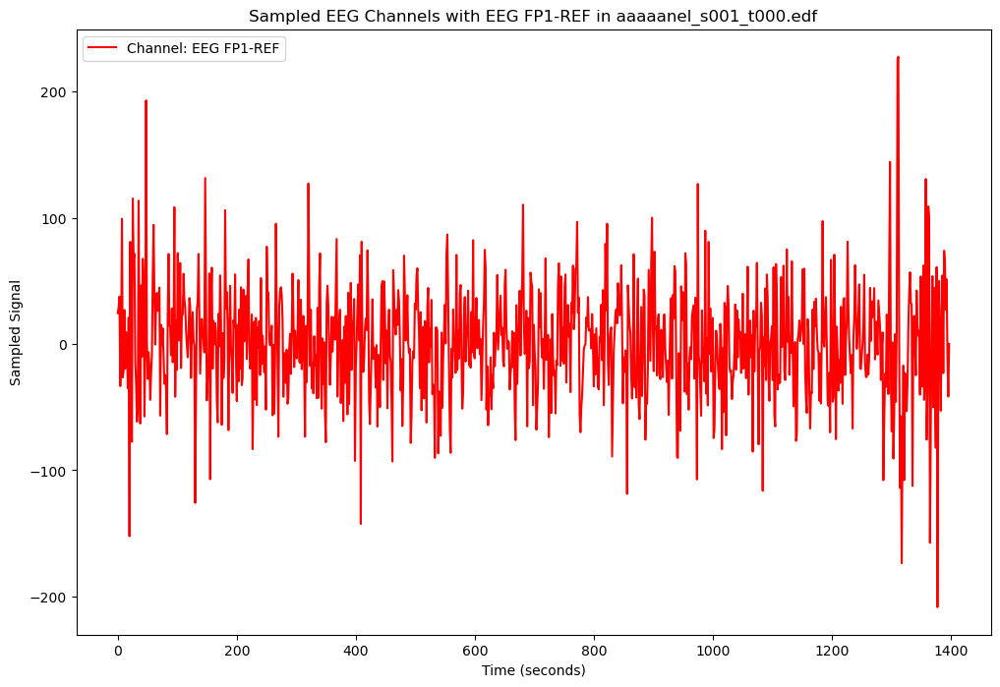

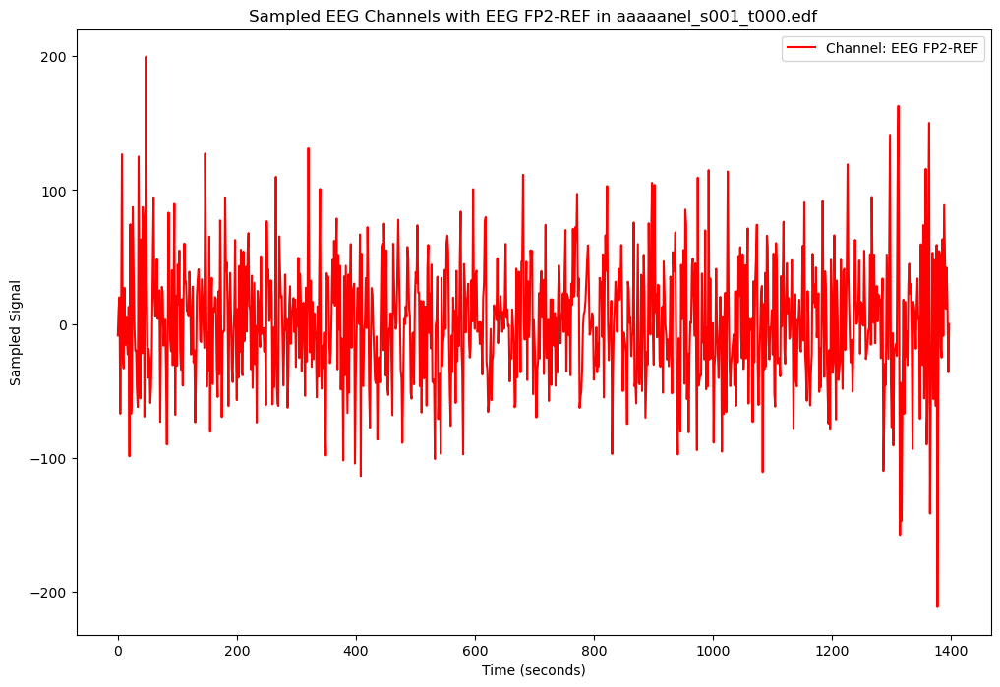

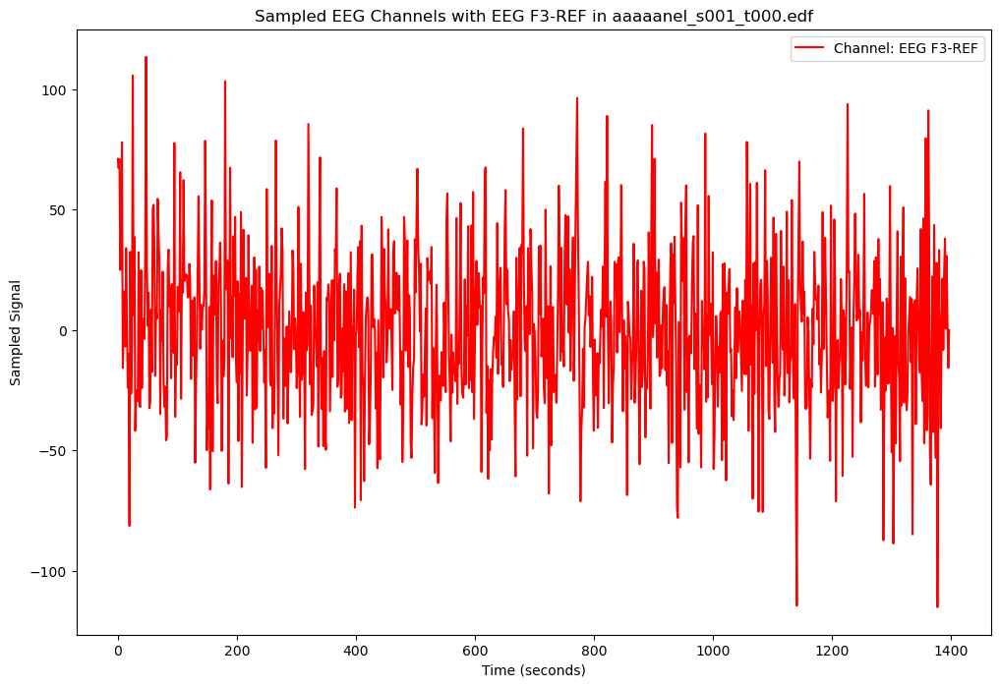

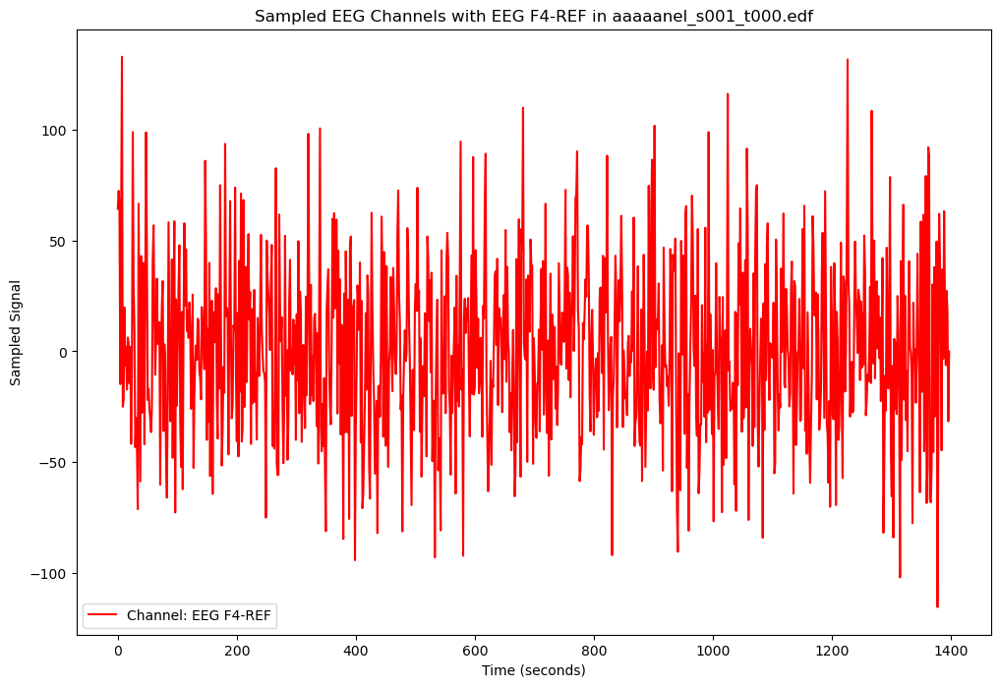

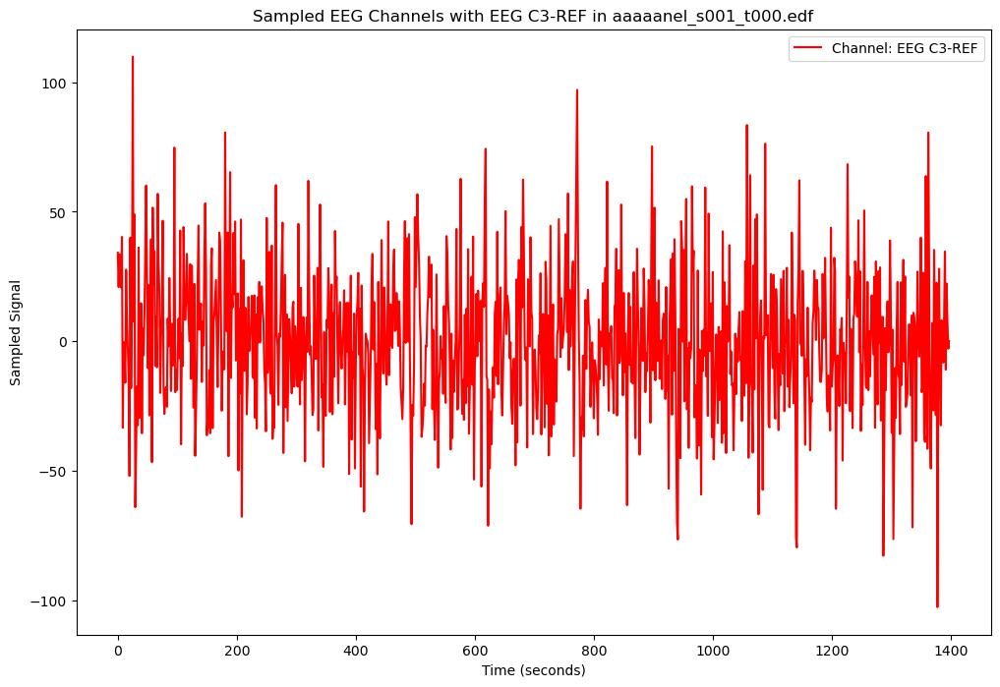

...

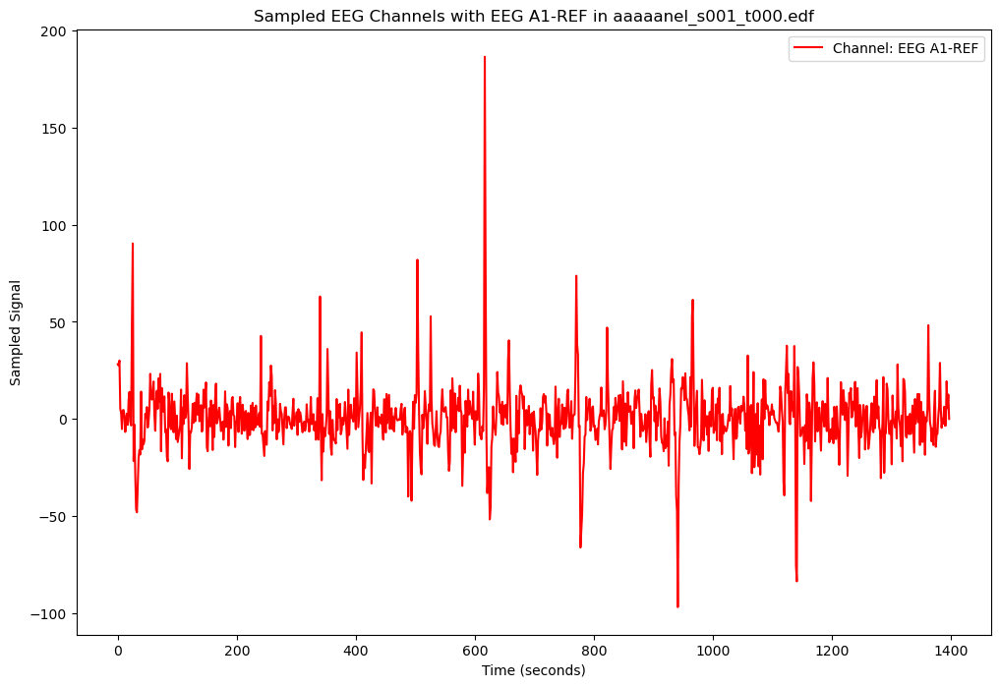

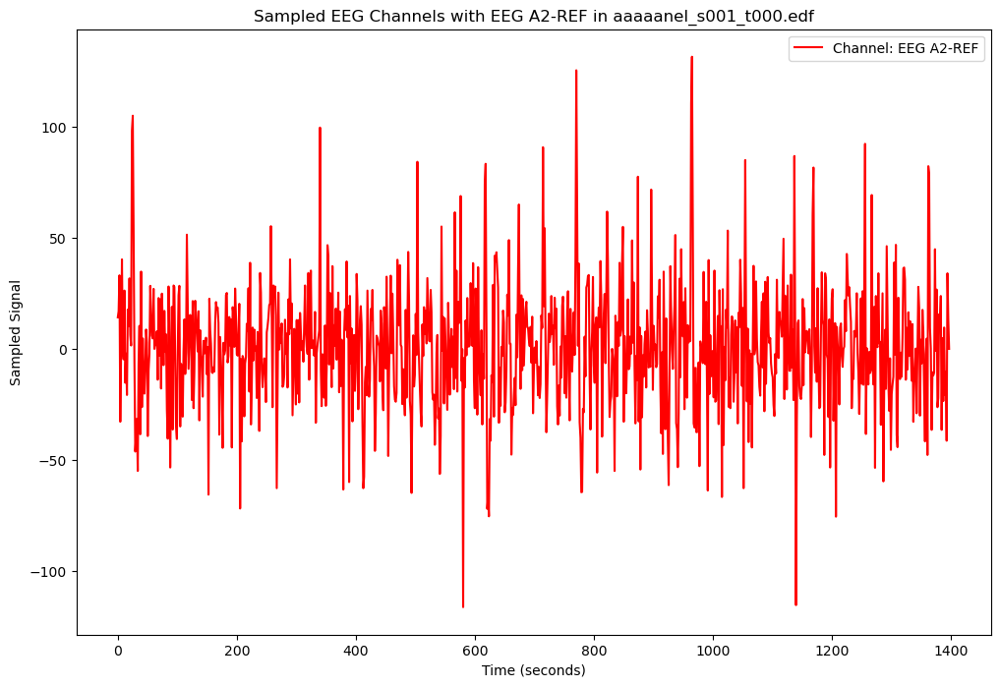

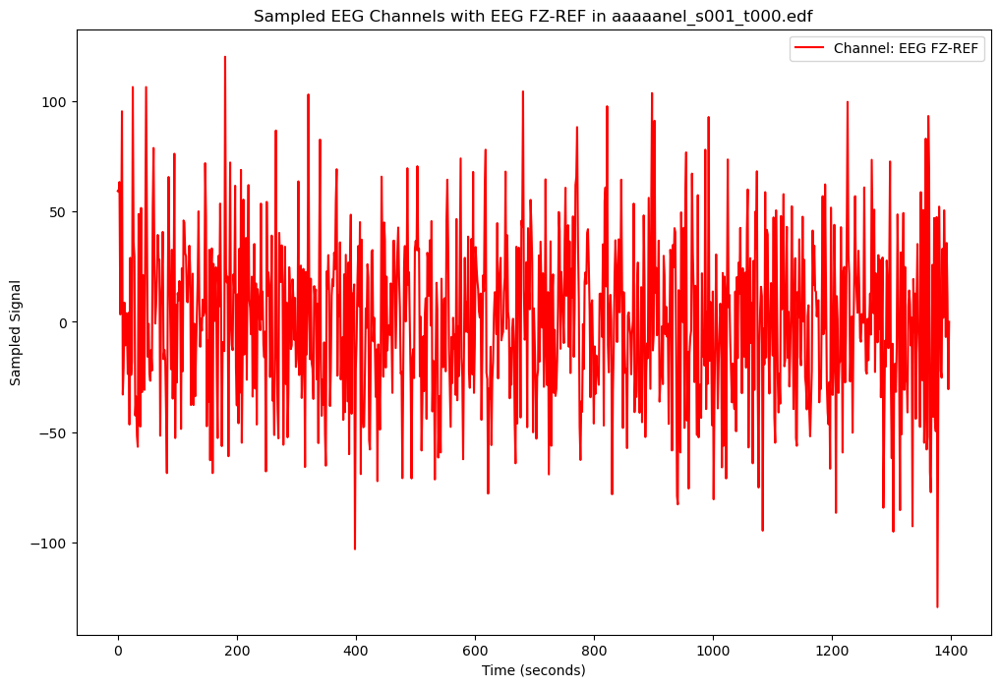

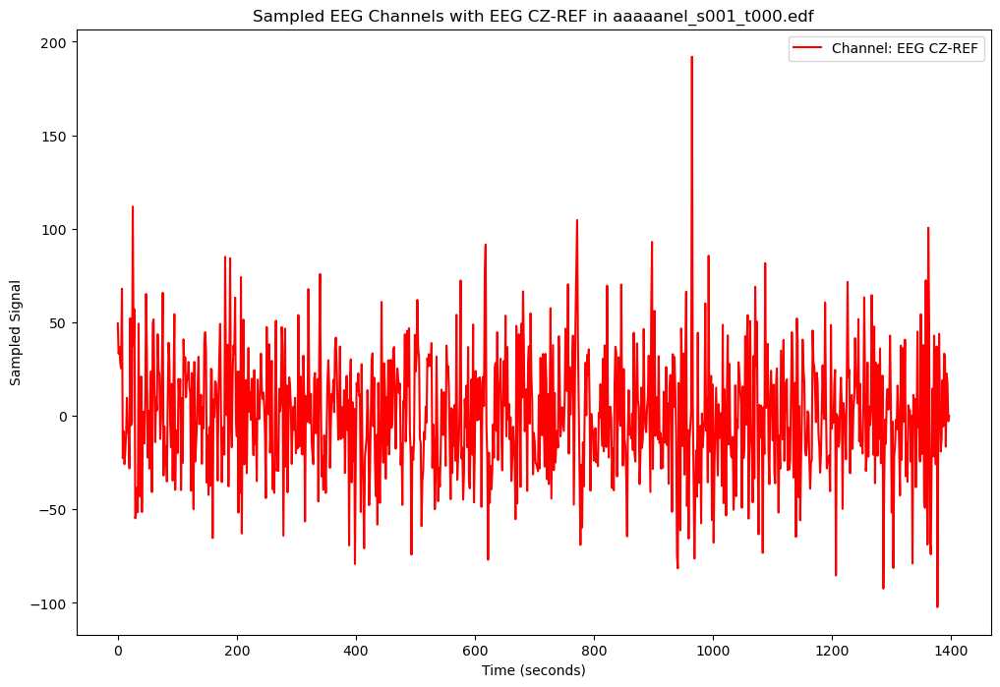

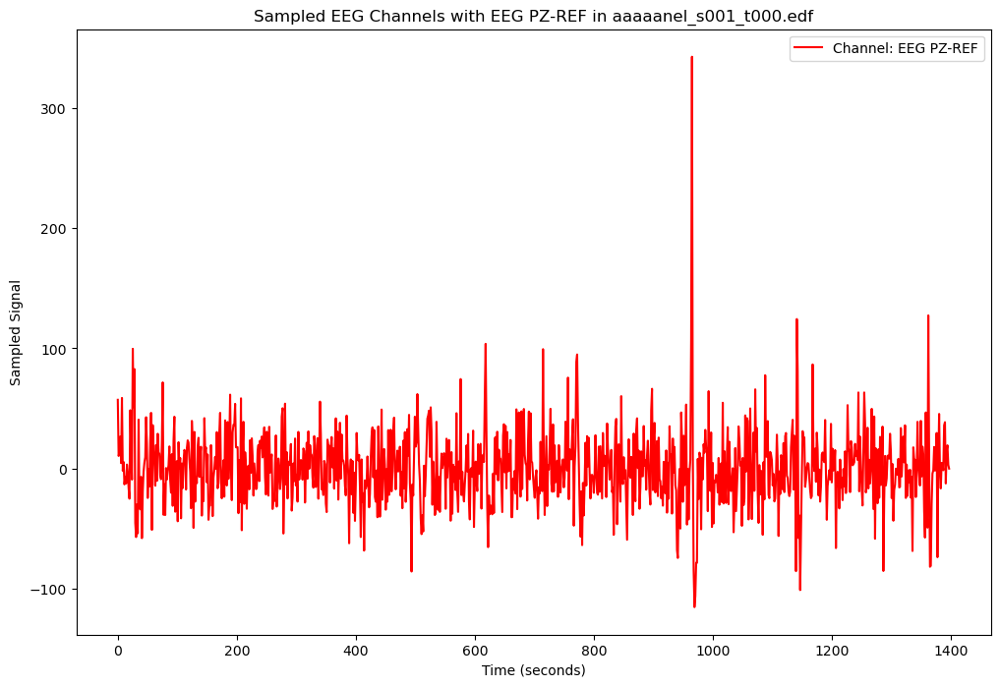

c:\ProgramData\Anaconda3\envs\cuda11.6\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


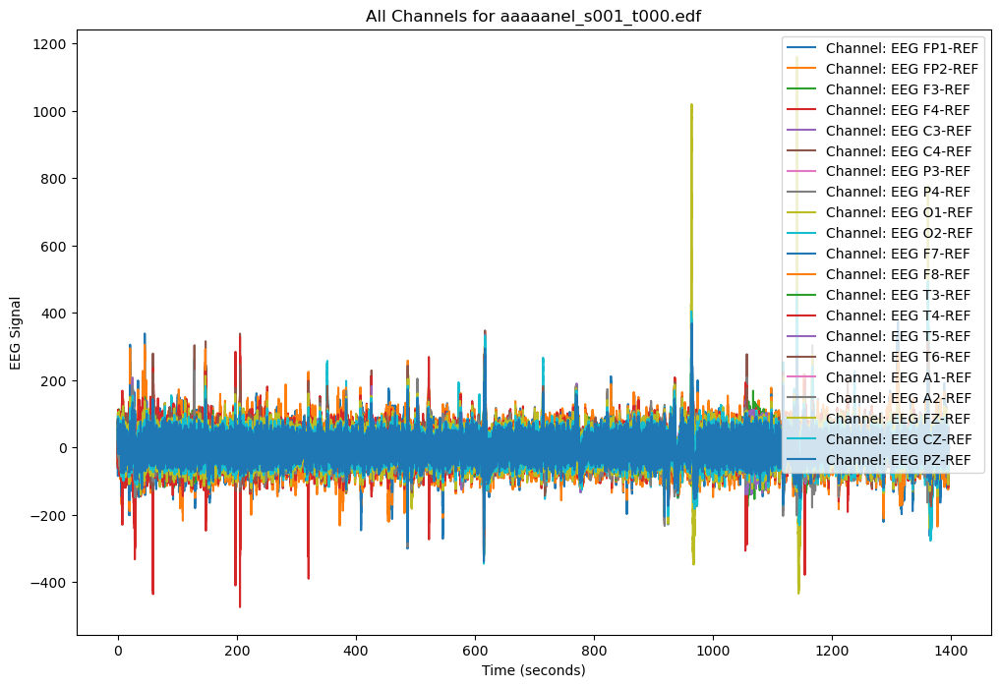

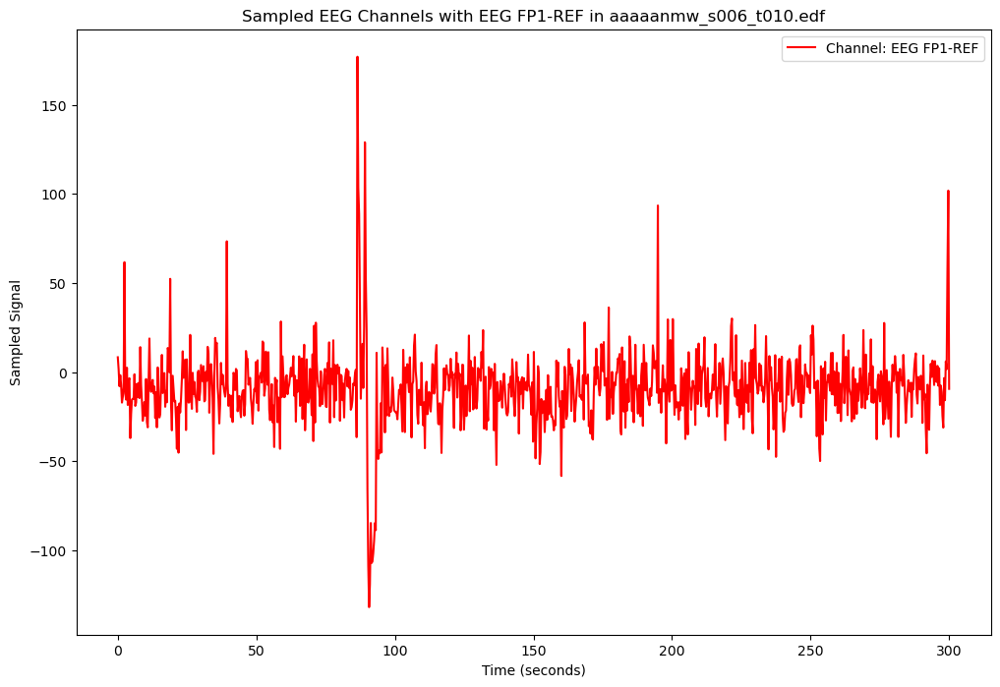

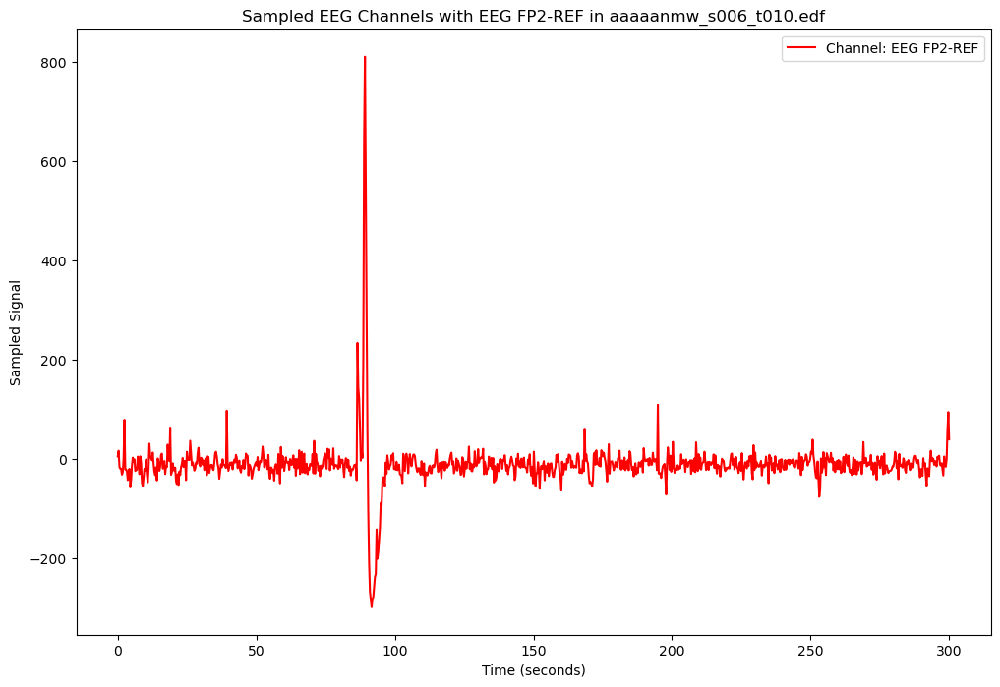

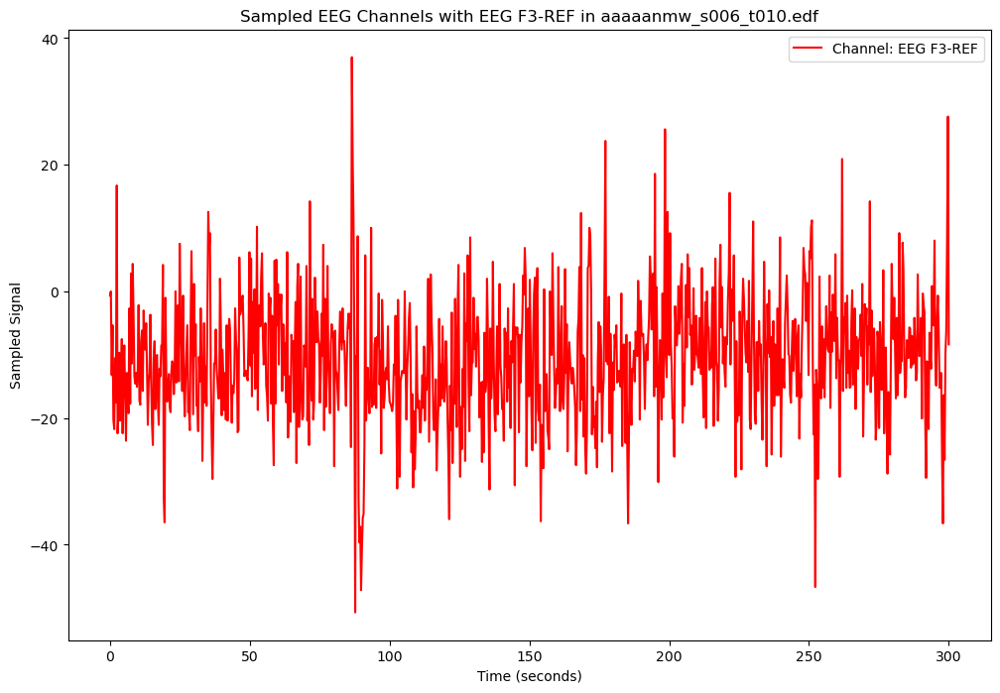

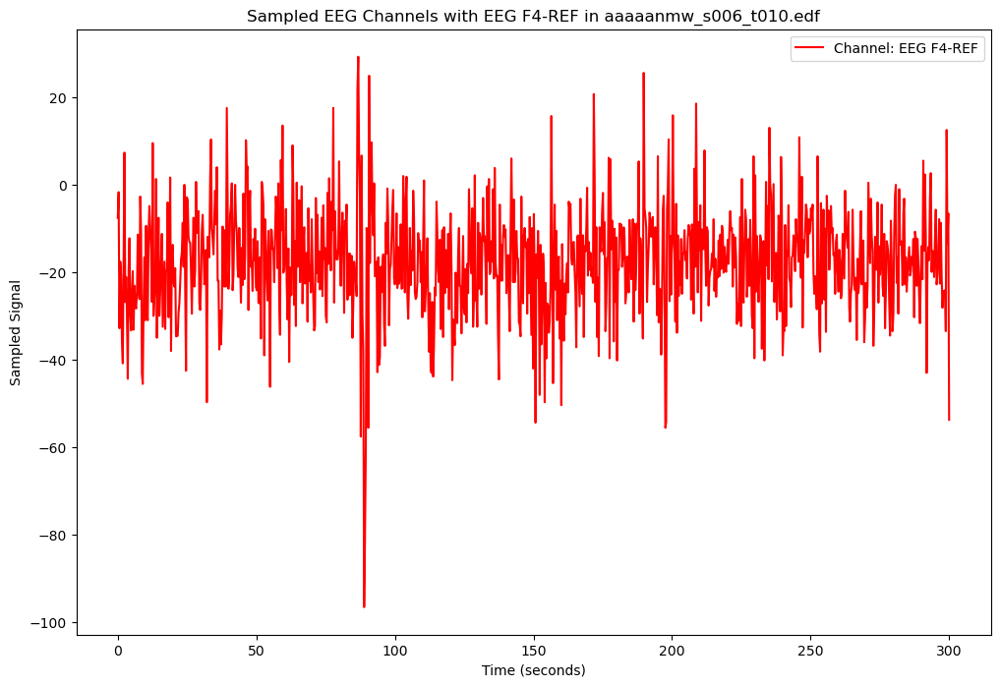

...

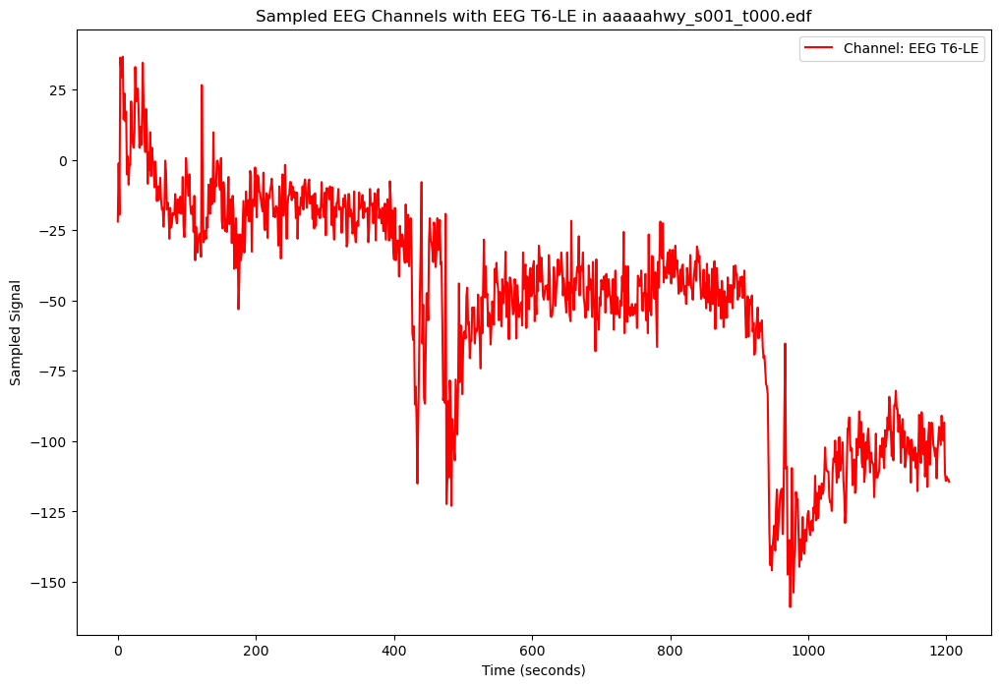

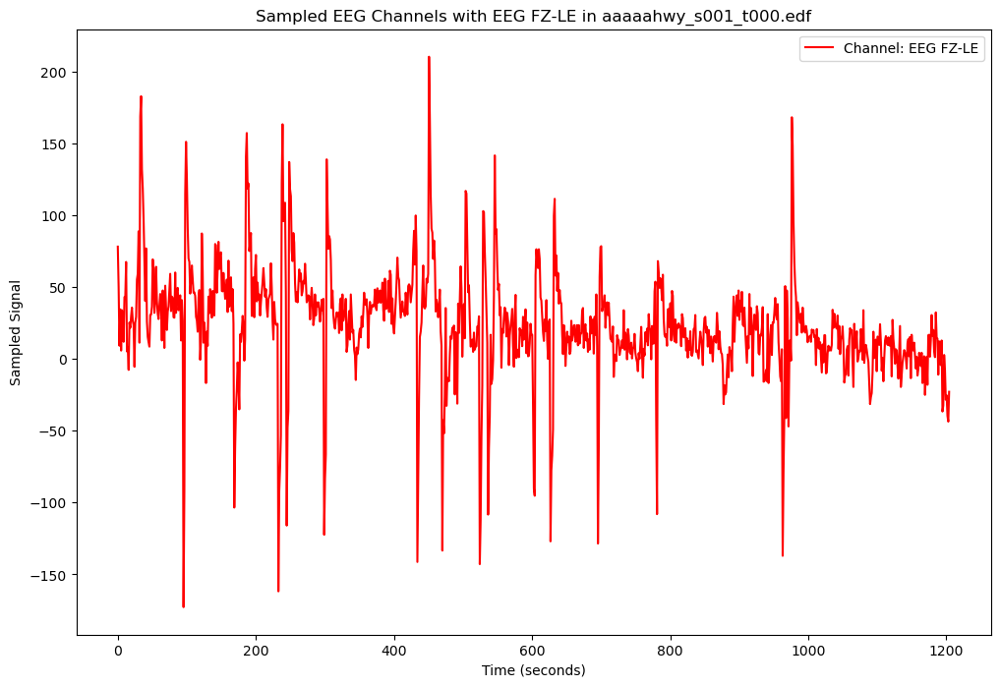

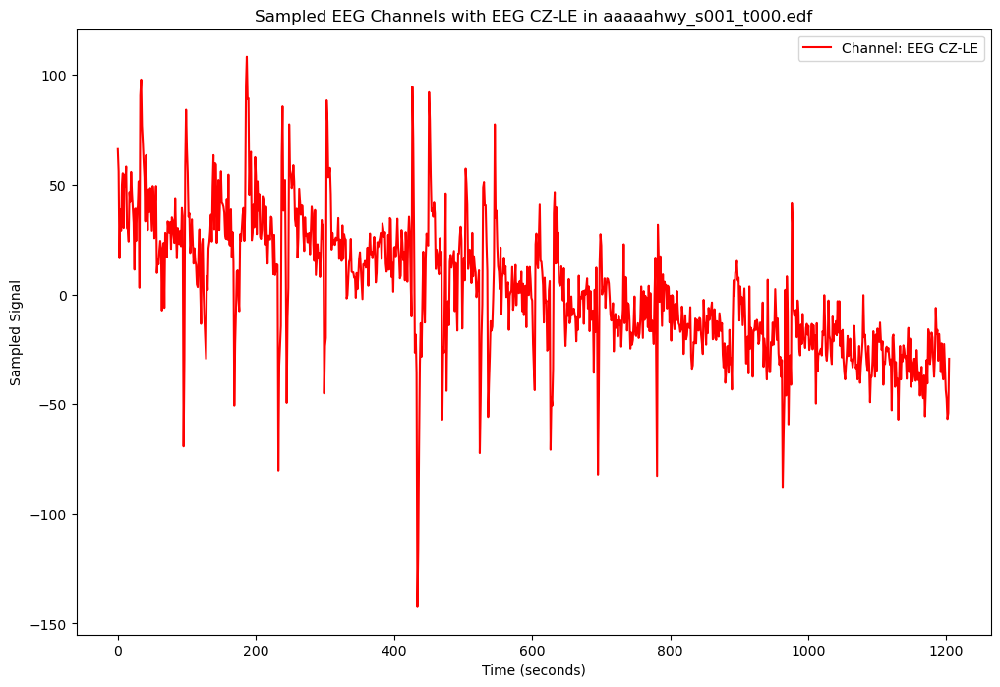

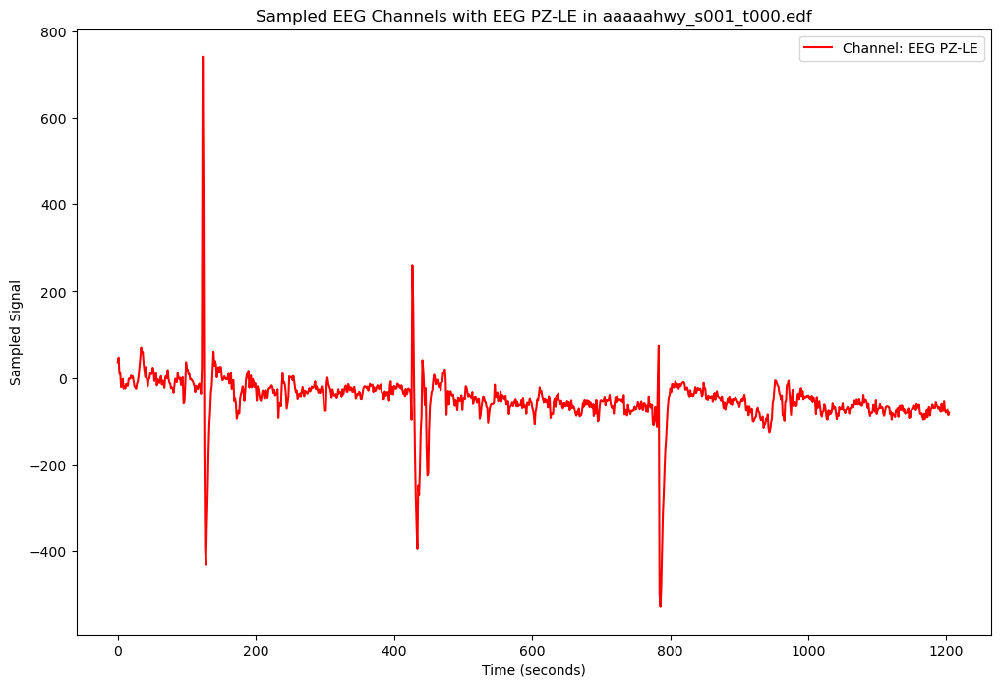

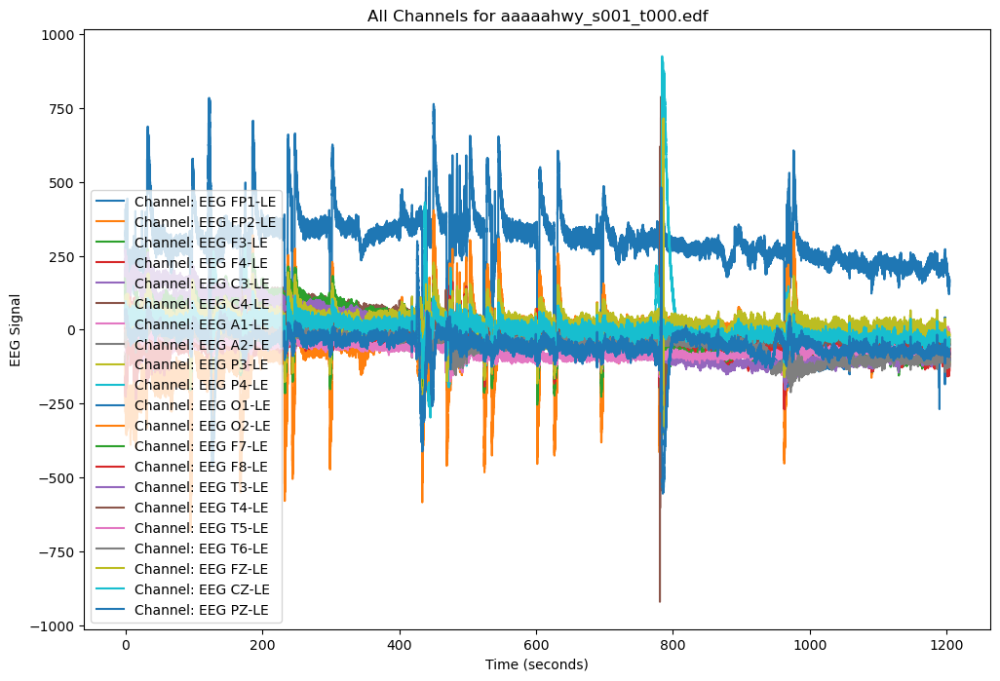

In [26]:
import os
import numpy as np
import pyedflib
import matplotlib.pyplot as plt
from scipy.signal import resample, butter, lfilter

tmin = 1 * 60
tmax = 6 * 60
sfreq_target = 200  # 200Hz 리샘플링
clip_threshold = 500  # outlier 값 클리핑 임계값

# 선택된 파일 리스트 (랜덤하게 10개 선택)
# selected_files = np.random.choice(selected_files, size=10, replace=False)

# 각 데이터 파일에 대해 채널 수만큼 plt를 만들어 plotting
for file_path in random_files:
    with pyedflib.EdfReader(file_path) as f:
        channel_labels = f.getSignalLabels()
        num_channels = len(channel_labels)
        sample_rate = f.getSampleFrequency(0)  # 첫 번째 채널의 샘플링 주파수를 가져옴

        # 파일명 가져오기
        file_name = os.path.basename(file_path)

        # 각 채널에 대해 plt 생성 및 시각화
        for ch_idx, ch_name in enumerate(channel_labels):
            if ch_name in combined_ch_names:  # combined_ch_names에 있는 채널만 시각화
                plt.figure(figsize=(12, 8))

                # 해당 채널의 데이터를 저장할 리스트
                sampled_data_list = []

                # EEG 데이터 불러오기 및 전처리
                eeg_data = f.readSignal(ch_idx)

                # 데이터 샘플링
                num_samples = len(eeg_data)
                time = np.linspace(0, num_samples / sample_rate, num_samples)
                sample_indices = np.linspace(0, num_samples - 1, 1000).astype(int)
                sampled_data = eeg_data[sample_indices]
                sampled_data_list.append(sampled_data)

                # 모든 채널을 흑색으로 그리기
                for data in sampled_data_list[:-1]:
                    plt.plot(time[sample_indices], data, color='black', alpha=0.3)  # 투명도 조절

                # 현재 채널을 빨간색으로 뚜렷하게 그리기
                red_channel_data = sampled_data_list[-1]
                plt.plot(time[sample_indices], red_channel_data, color='red', label=f"Channel: {ch_name}")

                plt.xlabel("Time (seconds)")
                plt.ylabel("Sampled Signal")
                plt.title(f"Sampled EEG Channels with {ch_name} in {file_name}")
                plt.legend()
                plt.show()

        # 하나의 데이터당 모든 채널을 색깔별로 plotting한 그래프
        plt.figure(figsize=(12, 8))
        for ch_idx, ch_name in enumerate(channel_labels):
            if ch_name in combined_ch_names:  # combined_ch_names에 있는 채널만 시각화
                eeg_data = f.readSignal(ch_idx)
                plt.plot(time, eeg_data, label=f"Channel: {ch_name}")
        plt.xlabel("Time (seconds)")
        plt.ylabel("EEG Signal")
        plt.title(f"All Channels for {file_name}")
        plt.legend()
        plt.show()


In [27]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample, butter, lfilter

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 선택된 파일 리스트 (랜덤하게 10개 선택)
# selected_files = np.random.choice(selected_files, size=10, replace=False)

# # 각 데이터 파일에 대해 채널 수만큼 plt를 만들어 plotting
# for file_path in selected_files:
#     with pyedflib.EdfReader(file_path) as f:
#         channel_labels = f.getSignalLabels()
#         num_channels = len(channel_labels)
#         sample_rate = f.getSampleFrequency(0)  # 첫 번째 채널의 샘플링 주파수를 가져옴

#         # 파일명 가져오기
#         file_name = os.path.basename(file_path)

#         # 각 채널에 대해 plt 생성 및 시각화
#         for ch_idx, ch_name in enumerate(channel_labels):
#             plt.figure(figsize=(12, 8))

#             # 해당 채널의 데이터를 저장할 리스트
#             sampled_data_list = []

#             # EEG 데이터 불러오기 및 전처리
#             eeg_data = f.readSignal(ch_idx)

#             # 데이터 샘플링
#             num_samples = len(eeg_data)
#             time = np.linspace(0, num_samples / sample_rate, num_samples)
#             sample_indices = np.linspace(0, num_samples - 1, 1000).astype(int)
#             sampled_data = eeg_data[sample_indices]
#             sampled_data_list.append(sampled_data)

#             # 모든 채널을 흑색으로 그리기
#             for data in sampled_data_list[:-1]:
#                 plt.plot(time[sample_indices], data, color='black', alpha=0.3)  # 투명도 조절

#             # 현재 채널을 빨간색으로 뚜렷하게 그리기
#             red_channel_data = sampled_data_list[-1]
#             plt.plot(time[sample_indices], red_channel_data, color='red', label=f"Channel: {ch_name}")

#             plt.xlabel("Time (seconds)")
#             plt.ylabel("Sampled Signal")
#             plt.title(f"Sampled EEG Channels with {ch_name} in {file_name}")
#             plt.legend()
#             plt.show()


In [28]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample, butter, lfilter

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 새로운 figure 생성
# plt.figure(figsize=(12, 8))

# # 선택된 파일 리스트 (랜덤하게 10개 선택)
# selected_files = np.random.choice(selected_files, size=10, replace=False)

# # 각 채널에 대해 데이터 샘플링하여 시각화
# for ch_idx, ch_name in enumerate(combined_ch_names):
#     plt.figure(figsize=(12, 8))

#     # 해당 채널의 데이터를 저장할 리스트
#     sampled_data_list = []

#     for file_path in selected_files:
#         with pyedflib.EdfReader(file_path) as f:
#             channel_labels = f.getSignalLabels()
#             sample_frequencies = f.getSampleFrequencies()

#             if ch_name in channel_labels:
#                 channel_index = channel_labels.index(ch_name)

#                 # EEG 데이터 불러오기 및 전처리
#                 eeg_data = f.readSignal(channel_index)

#                 # 데이터 샘플링
#                 sample_indices = np.linspace(0, len(eeg_data) - 1, 1000).astype(int)
#                 sampled_data = eeg_data[sample_indices]
#                 sampled_data_list.append(sampled_data)

#     # 20개 채널을 흑색으로 그리기
#     for data in sampled_data_list[:-1]:
#         plt.plot(time, data, color='black')

#     # 1개 채널을 빨간색으로 그리기
#     red_channel_data = sampled_data_list[-1]
#     # 채널 데이터의 스케일 조정
#     scale_factor = np.max(np.abs(red_channel_data)) / 5  # 원하는 스케일 조정값 설정
#     plt.plot(time, red_channel_data / scale_factor, color='red', label=f"Channel: {ch_name}")

#     # 파일명 가져오기
#     plt_title = f"Sampled EEG Channels with {ch_name} in {file_path}"

#     plt.xlabel("Time (seconds)")
#     plt.ylabel("Sampled Signal")
#     plt.title(plt_title)
#     plt.legend()
#     plt.show()


In [29]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample, butter, lfilter

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 새로운 figure 생성
# plt.figure(figsize=(12, 8))

# # 선택된 파일 리스트 (랜덤하게 10개 선택)
# selected_files = np.random.choice(selected_files, size=10, replace=False)

# # 각 채널에 대해 데이터 샘플링하여 시각화
# for ch_idx, ch_name in enumerate(combined_ch_names):
#     plt.figure(figsize=(12, 8))

#     # 해당 채널의 데이터를 저장할 리스트
#     sampled_data_list = []

#     for file_path in selected_files:
#         with pyedflib.EdfReader(file_path) as f:
#             channel_labels = f.getSignalLabels()
#             sample_frequencies = f.getSampleFrequencies()

#             if ch_name in channel_labels:
#                 channel_index = channel_labels.index(ch_name)

#                 # EEG 데이터 불러오기 및 전처리
#                 eeg_data = f.readSignal(channel_index)

#                 # 데이터 샘플링
#                 sample_indices = np.linspace(0, len(eeg_data) - 1, 1000).astype(int)
#                 sampled_data = eeg_data[sample_indices]
#                 sampled_data_list.append(sampled_data)

#     # 20개 채널을 흑색으로 그리기
#     for data in sampled_data_list[:-1]:
#         plt.plot(time, data, color='black')

#     # 1개 채널을 빨간색으로 그리기
#     plt.plot(time, sampled_data_list[-1], color='red', label=f"Channel: {ch_name}")

#     # 파일명 가져오기
#     # file_names = [os.path.basename(file_path) for file_path in selected_files]
#     plt_title = f"Sampled EEG Channels with {ch_name} in {file_path}"

#     plt.xlabel("Time (seconds)")
#     plt.ylabel("Sampled Signal")
#     plt.title(plt_title)
#     plt.legend()
#     plt.show()


얘는 별거 없음 똑같은 plotting

In [30]:
# import os
# import numpy as np
# import pyedflib
# import matplotlib.pyplot as plt
# from scipy.signal import resample, butter, lfilter

# tmin = 1 * 60
# tmax = 6 * 60
# sfreq_target = 200  # 200Hz 리샘플링
# clip_threshold = 500  # outlier 값 클리핑 임계값

# # 작업 파일들을 순회하면서 EEG 데이터 전처리 및 시각화
# for file_path in selected_files[:10]:  # 모든 파일 처리
#     with pyedflib.EdfReader(file_path) as f:
#         channel_labels = f.getSignalLabels()
#         sample_frequencies = f.getSampleFrequencies()
#         # EEG 채널만 추출
#         # eeg_channels = [ch for ch in channel_labels if ch.startswith("EEG")]
#         eeg_channels = [ch for ch in channel_labels if ch in combined_ch_names]
#         if len(eeg_channels) > 0:  # EEG 채널이 존재하는 경우에만 처리
#             eeg_indices = [channel_labels.index(ch) for ch in eeg_channels]

#             # EEG 데이터 불러오기 및 전처리
#             eeg_data = [f.readSignal(idx) for idx in eeg_indices]

#             # Bandpass 필터링 적용
#             eeg_data_filtered = []
#             for signal in eeg_data:
#                 filtered_signal = butter_bandpass_filter(signal, lowcut, highcut, sfreq_target, order)
#                 eeg_data_filtered.append(filtered_signal)

#             # 리샘플링
#             num_original_samples = len(eeg_data_filtered[0])
#             num_target_samples = int(num_original_samples * (sfreq_target / max(sample_frequencies)))
#             eeg_data_resampled = [resample(signal, num_target_samples) for signal in eeg_data_filtered]

#             # EEG 참조 적용 (여기서 'average'로 referencing을 적용)
#             eeg_data_mean = np.mean(eeg_data_resampled, axis=0)
#             eeg_data_referenced = [signal - eeg_data_mean for signal in eeg_data_resampled]

#             # zero mean std 정규화
#             eeg_data_normalized = [(signal - np.mean(signal)) / np.std(signal) for signal in eeg_data_referenced]

#             # outlier 값 클리핑
#             eeg_data_clipped = [np.clip(signal, -clip_threshold, clip_threshold) for signal in eeg_data_normalized]

#             # 시간 배열 생성
#             duration = len(eeg_data_clipped[0]) / sfreq_target
#             time = np.linspace(0, duration, len(eeg_data_clipped[0]))

#             # 시각화
#             plt.figure(figsize=(12, 8))
#             for idx, channel_index in enumerate(eeg_indices):
#                 plt.plot(time, eeg_data_clipped[idx], label=f"Ch {channel_index + 1}: {channel_labels[channel_index]}")
#             plt.xlabel("Time (seconds)")
#             plt.ylabel("Filtered, Referenced, Normalized, and Clipped Signal")
#             plt.title(f"Processed EEG Channels from EDF File: {file_path}")
#             plt.legend(loc='upper right')
#             plt.show()


밑에껀 dict다룰 때 참고

In [31]:
# # 채널 분포 시각화
# plt.figure(figsize=(10, 8))
# for ch_type, ch_mapping_dict in ch_mapping.items():
#     # 각 채널 종류별로 데이터 추출 및 시각화
#     for ch_name in ch_mapping_dict:
#         # print(ch_name) => EEG A1-REF
#         if ch_name.lower() in [label.lower() for label in channel_labels]:
#             # print(ch_name) =>EEG A1-REF
#             ch_indices = [channel_labels.index(ch_name)]
#             if not ch_indices:
#                 continue  # 해당 채널이 데이터에 없는 경우 건너뜁니다.

#             # 모든 데이터에서 해당 채널의 데이터 추출
#             ch_data = []
#             for file_path in selected_files:
#                 with pyedflib.EdfReader(file_path) as f:
#                     ch_data.extend([f.readSignal(idx) for idx in ch_indices])

#             ch_data_mean = np.mean(ch_data, axis=0)
#             ch_data_std = np.std(ch_data, axis=0)

#             # 시각화
#             plt.plot(ch_data_mean, label=f"{ch_type.upper()} mean - {ch_name}")
#             plt.fill_between(range(len(ch_data_mean)), ch_data_mean - ch_data_std, ch_data_mean + ch_data_std, alpha=0.3)

# plt.xlabel("Sample")
# plt.ylabel("Signal Value")
# plt.title("Channel Distribution across Selected EDF Files")
# plt.legend()
# plt.show()


## 새로운 edf를 만들 필요없음(밑에꺼무시)

In [ ]:
# # 폴더가 존재하지 않으면 생성
# if not os.path.exists(output_dir):
#     os.makedirs(output_dir)

# # 작업 폴더 내의 모든 파일에 대해 반복
# for file_path in working_files:
#     with pyedflib.EdfReader(file_path[0]) as f:
#         # 모든 채널 이름 가져오기
#         # all_channels = f.getSignalLabels()
        
#         # # EEG 채널만 필터링
#         # eeg_channels = [ch for ch in all_channels if ch.startswith("EEG")]
        
#         # # EEG 채널 인덱스 가져오기
#         # eeg_indices = [f.getSignalLabels().index(ch) for ch in eeg_channels]    
#         # # # EEG 채널 데이터 가져오기
#         # eeg_data = [f.readSignal(ch) for ch in eeg_indices]
#         # print(eeg_data)
#         # # EEG 데이터를 담은 새로운 EDF 파일 생성
#         new_path=file_path[0].split('\\')[-5:]
#         combined_path = os.path.join(output_dir,'\\'.join(new_path))
#         new_folder_path = os.path.dirname(combined_path)
#         os.makedirs(new_folder_path, exist_ok=True)
        
#         all_channels = f.getSignalLabels()
#         eeg_channels = [ch for ch in all_channels if ch.startswith("EEG")]
#         eeg_indices = [f.getSignalLabels().index(ch) for ch in eeg_channels]    
#         eeg_data = [f.readSignal(ch) for ch in eeg_indices]
#         # with pyedflib.EdfWriter(combined_path, len(eeg_channels)) as writer:
#         #     for i, channel in enumerate(eeg_channels):
#         #         writer.setSignalHeader(i, {"label": channel, "dimension": "uV"})

#         #     # 시간 포인트별로 데이터 작성
#         #     num_samples = eeg_data[0].shape[0]
#         #     # print(num_samples)
#         #     for time_point in range(num_samples):
#         #         samples = [data[time_point] for data in eeg_data]
#         #         writer.writeSamples(samples) 
#         with pyedflib.EdfWriter(combined_path, len(eeg_channels)) as writer:
#             for i, channel in enumerate(eeg_channels):
#                 writer.setSignalHeader(i, {"label": channel, "dimension": "uV"})
#             writer.writeSamples(eeg_data)
        
#         print(f"Saved EEG channels to: {new_folder_path}")


ValueError: zero-size array to reduction operation maximum which has no identity

In [ ]:
data_path=r'C:\Users\dhc40\AppData\Roaming\MobaXterm\home'
# print(data_path)
new_raw_path=data_path+r'\v2.0.0\new_edf'
new_working_files = []
for (dir_path, dir_names, file_names) in os.walk(new_raw_path):
    max_eeg = [re.search('t(\d*)',file.split('/')[-1])[1] for file in file_names]
    m = max(max_eeg) if len(max_eeg) >= 1 else 0
    for file in file_names:
        if file.endswith('.edf'):
            new_working_files.append((dir_path + '\\' + file, m))

['EEG FP1-LE', 'EEG FP2-LE', 'EEG F3-LE', 'EEG F4-LE', 'EEG C3-LE', 'EEG C4-LE', 'EEG A1-LE', 'EEG A2-LE', 'EEG P3-LE', 'EEG P4-LE', 'EEG O1-LE', 'EEG O2-LE', 'EEG F7-LE', 'EEG F8-LE', 'EEG T3-LE', 'EEG T4-LE', 'EEG T5-LE', 'EEG T6-LE', 'EEG FZ-LE', 'EEG CZ-LE', 'EEG PZ-LE', 'EEG OZ-LE', 'EEG PG1-LE', 'EEG PG2-LE', 'EEG EKG-LE', 'EEG SP2-LE', 'EEG SP1-LE', 'EEG RLC-LE', 'EEG LUC-LE', 'EEG 30-LE', 'EEG T1-LE', 'EEG T2-LE']


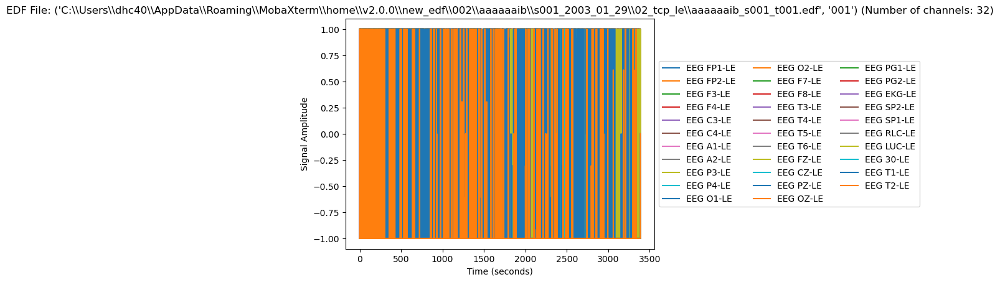

['EEG FP1-LE', 'EEG FP2-LE', 'EEG F3-LE', 'EEG F4-LE', 'EEG C3-LE', 'EEG C4-LE', 'EEG A1-LE', 'EEG A2-LE', 'EEG P3-LE', 'EEG P4-LE', 'EEG O1-LE', 'EEG O2-LE', 'EEG F7-LE', 'EEG F8-LE', 'EEG T3-LE', 'EEG T4-LE', 'EEG T5-LE', 'EEG T6-LE', 'EEG FZ-LE', 'EEG CZ-LE', 'EEG PZ-LE', 'EEG OZ-LE', 'EEG PG1-LE', 'EEG PG2-LE', 'EEG EKG-LE', 'EEG SP2-LE', 'EEG SP1-LE', 'EEG 28-LE', 'EEG 29-LE', 'EEG 30-LE', 'EEG T1-LE', 'EEG T2-LE']


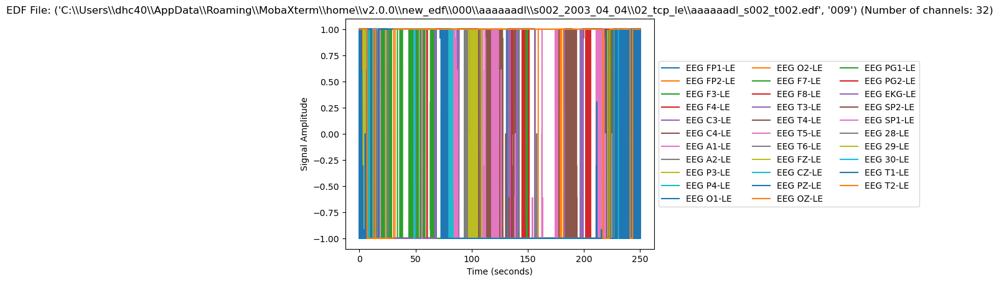

['EEG FP1-REF', 'EEG FP2-REF', 'EEG F3-REF', 'EEG F4-REF', 'EEG C3-REF', 'EEG C4-REF', 'EEG P3-REF', 'EEG P4-REF', 'EEG O1-REF', 'EEG O2-REF', 'EEG F7-REF', 'EEG F8-REF', 'EEG T3-REF', 'EEG T4-REF', 'EEG T5-REF', 'EEG T6-REF', 'EEG T1-REF', 'EEG T2-REF', 'EEG FZ-REF', 'EEG CZ-REF', 'EEG PZ-REF', 'EEG EKG1-REF', 'EEG C3P-REF', 'EEG C4P-REF', 'EEG SP1-REF', 'EEG SP2-REF', 'EEG A1-REF', 'EEG A2-REF']


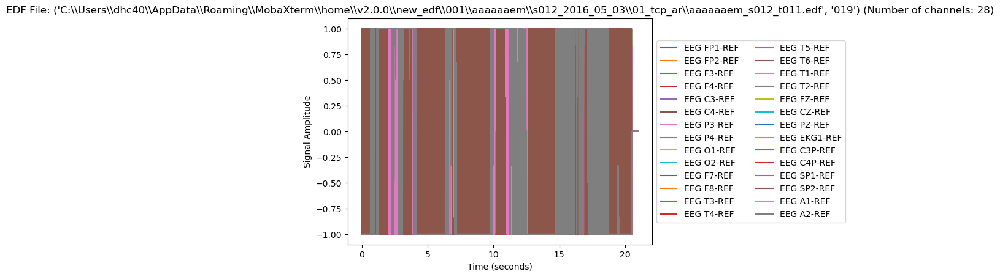

['EEG FP1-LE', 'EEG FP2-LE', 'EEG F3-LE', 'EEG F4-LE', 'EEG C3-LE', 'EEG C4-LE', 'EEG A1-LE', 'EEG A2-LE', 'EEG P3-LE', 'EEG P4-LE', 'EEG O1-LE', 'EEG O2-LE', 'EEG F7-LE', 'EEG F8-LE', 'EEG T3-LE', 'EEG T4-LE', 'EEG T5-LE', 'EEG T6-LE', 'EEG FZ-LE', 'EEG CZ-LE', 'EEG PZ-LE', 'EEG OZ-LE', 'EEG PG1-LE', 'EEG PG2-LE', 'EEG EKG-LE', 'EEG SP2-LE', 'EEG SP1-LE', 'EEG 28-LE', 'EEG 29-LE', 'EEG 30-LE', 'EEG T1-LE', 'EEG T2-LE']


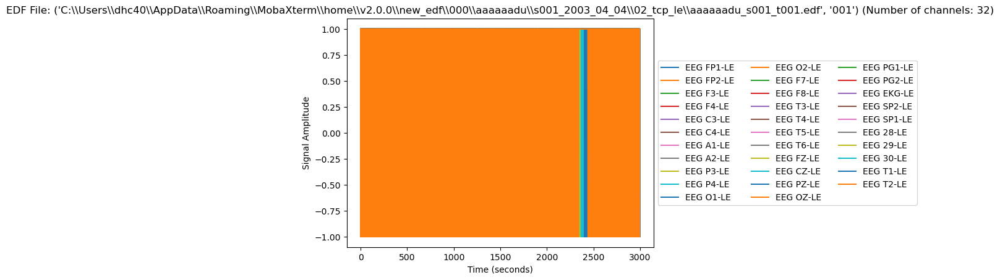

['EEG FP1-REF', 'EEG FP2-REF', 'EEG F3-REF', 'EEG F4-REF', 'EEG C3-REF', 'EEG C4-REF', 'EEG P3-REF', 'EEG P4-REF', 'EEG O1-REF', 'EEG O2-REF', 'EEG F7-REF', 'EEG F8-REF', 'EEG T3-REF', 'EEG T4-REF', 'EEG T5-REF', 'EEG T6-REF', 'EEG FZ-REF', 'EEG CZ-REF', 'EEG PZ-REF', 'EEG EKG-REF', 'EEG A1-REF', 'EEG A2-REF', 'EEG T1-REF', 'EEG T2-REF', 'EEG SP1-REF', 'EEG SP2-REF', 'EEG LUC-REF', 'EEG RLC-REF', 'EEG RESP1-REF', 'EEG RESP2-REF', 'EEG 31-REF', 'EEG 32-REF']


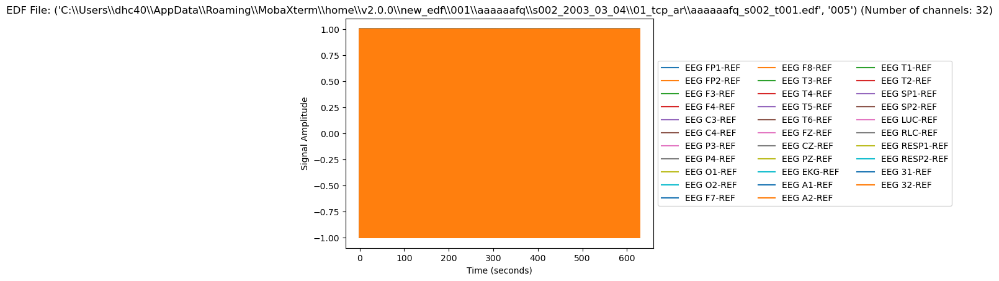

In [ ]:
# 랜덤하게 선택할 파일의 개수 설정
num_files_to_visualize = 5
random_files = random.sample(new_working_files, num_files_to_visualize)

# 파일들을 순회하면서 시각화
for file_path in random_files:
    # EDF 파일 열기
    edf_reader = pyedflib.EdfReader(file_path[0])

    # 채널 정보 확인
    num_channels = edf_reader.signals_in_file
    channel_labels = edf_reader.getSignalLabels()
    print(channel_labels)
    sample_frequencies = edf_reader.getSampleFrequencies()

    # 시각화할 전체 그래프 생성
    plt.figure()

    # 채널별로 시그널 데이터를 가져와서 시각화
    for channel_index in range(num_channels):
        signal = edf_reader.readSignal(channel_index)

        # 시간 배열 생성 (시그널 데이터의 길이에 따라 샘플 개수 만큼 생성)
        sample_frequency = edf_reader.getSampleFrequencies()[channel_index]
        duration = len(signal) / sample_frequency
        time = np.linspace(0, duration, len(signal))

        # 채널 이름과 시그널 데이터를 한 그래프에 시각화
        plt.plot(time, signal, label=channel_labels[channel_index])

    # 전체 그래프 설정
    plt.xlabel("Time (seconds)")
    plt.ylabel("Signal Amplitude")
    plt.title(f"EDF File: {file_path} (Number of channels: {num_channels})")

    # 범례 위치와 가로 정렬 개수 설정하여 범주를 그래프 구역 바깥에 옮김
    plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), ncol=num_channels // 10)

    # 파일 닫기
    edf_reader.close()

    plt.show()


In [ ]:
%pip install mne

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


DEPRECATION: omegaconf 2.0.6 has a non-standard dependency specifier PyYAML>=5.1.*. pip 23.3 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of omegaconf or contact the author to suggest that they release a version with a conforming dependency specifiers. Discussion can be found at https://github.com/pypa/pip/issues/12063

[notice] A new release of pip is available: 23.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
for file, m in working_files:
    split = file.split('/')
    data_type = split[8]
    config = split[9].split('_')[-1]
    patient_id = split[11]
    long = split[12].split('_')
    session = long[0].strip('s')
    date = f'{long[1]}/{long[2]}/{long[3].strip(patient_id)}' 
    segment = re.search('t(\d*)',split[13])[1]
    f = pyedflib.EdfReader(file)
    channels = str(f.signals_in_file)
    num_obs = str(f.getNSamples()[0])
    label_file = file[:-3]+'tse'
    with open(label_file,'r') as f:
        labels, durations = [], []
        for line in f.readlines()[2:]:
            labels.append(line.split(' ')[2])
            durations.append(line.split(' ')[1])
    sample_rate = str(float(num_obs) / float(durations[-1]))
    d[patient_id].append({'patient':patient_id,
                          'date':date, 
                          'session':session, 
                          'segment':segment, 
                          'total_segments':m, 
                          'labels':labels,
                          'durations': durations,
                          'channels':channels,
                          'number_obs': num_obs,
                          'sample_rate': sample_rate,
                          'config':config, 
                          'type':data_type, 
                          'loc':file,
                          'label_file': label_file
                         })

IndexError: list index out of range

In [ ]:
d['00008544']

[{'patient': '00008544',
  'date': '2012/01/',
  'session': '011',
  'segment': '008',
  'total_segments': '011',
  'labels': ['bckg'],
  'durations': ['601.0000'],
  'channels': '34',
  'number_obs': '153856',
  'sample_rate': '256.0',
  'config': 'ar',
  'type': 'dev_test',
  'loc': '/data2/dcgrzenda/tuh_eeg/data/raw/v1.5.0/edf/dev_test/01_tcp_ar/085/00008544/s011_2012_01_08/00008544_s011_t008.edf',
  'label_file': '/data2/dcgrzenda/tuh_eeg/data/raw/v1.5.0/edf/dev_test/01_tcp_ar/085/00008544/s011_2012_01_08/00008544_s011_t008.tse'},
 {'patient': '00008544',
  'date': '2012/01/',
  'session': '011',
  'segment': '004',
  'total_segments': '011',
  'labels': ['bckg'],
  'durations': ['601.0000'],
  'channels': '34',
  'number_obs': '153856',
  'sample_rate': '256.0',
  'config': 'ar',
  'type': 'dev_test',
  'loc': '/data2/dcgrzenda/tuh_eeg/data/raw/v1.5.0/edf/dev_test/01_tcp_ar/085/00008544/s011_2012_01_08/00008544_s011_t004.edf',
  'label_file': '/data2/dcgrzenda/tuh_eeg/data/raw/v1.

# Save and Load Dictionary

In [ ]:
# save the dictionary to json
with open(here.parent/'data_dict.json', 'w') as file:
     file.write(json.dumps(d))

In [ ]:
# load the file back in 
with open(here.parent/'data_dict.json', 'r') as file:
     data_dict = json.load(file)

In [ ]:
# make sure they are the same
data_dict['00004151'] == d['00004151']

True